#데이터 분석 및 시각화

###분석 데이터 셋
유튜브 메인 페이지 “탐색/인기" 섹션에서 기초한 데이터셋.   
특정 기간동안의 동영상 트렌드 기록/연구 및 데이터를 다양한 관점으로 관찰하고 인사이트를 도출하는데 사용됨.  
주어진 데이터셋은 유튜브에서 인기 동영상으로 선택된 비디오 기준으로 가공. 
하루에 한번씩 수집되었음.  
각각의 비디오가 인기 동영상에 처음 포착된 시점과 사라진 시점의 데이터가 기록 되어 있음. 
<br>
<br>

### 분석 데이터 설명
<br>

####양식

- 분석 및 시각화 코드
  - python 3.x
  - 라이브러리 제한은 없지만 pandas는 필수 사용
  - .py or .ipynb

- 제출 방식
결과를 도출하기 위해서 작성했던 전체 .py or .ipynb 코드와 모든 결과를 종합하여 .zip 파일로 제출  
(파일명 예시, junior_name_pretest.zip)
<br>

####문제 (해당 과제에 대한 정답은 없습니다)
- Q1. 데이터 타입별 시각화 (자유양식)
  - 전체기간 카테고리->채널->비디오 개수
  - 월별 카테고리->채널->비디오 개수
  - 월별 TOP10 채널 (분류 기준은 비디오 개수)
  - 주별 TOP5 채널 (분류 기준은 비디오 개수)
  - 월별 카테고리별 태그 키워드 순위

- Q2. 각각의 비디오는 시청자의 호응도(engagement)를 판단할수 있는 객관적인 지표
들이 있음  
ex) views, likes, dislikes, comments,...  
  - 비디오를 인기 동영상 기준에 부합하도록 분류할수 있는 새로운 지표를 개발하고
이 지표를 사용하여 engagement 와 어떤 상관관계가 있는지 설명하시오.

- Q3. Q1, Q2의 답을 자유양식으로 작성 후 PDF로 변환하여 첨부
(영어로 작성 선호하지만 선택 사항임)

In [133]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
pip install -U pandas-profiling

In [134]:
import pandas as pd
import pandas_profiling
from datetime import datetime
import re
from plotly.offline import plot
import plotly.graph_objs as go
from plotly.offline import plot, iplot
import numpy as np
import matplotlib.pyplot as plt
import copy

In [463]:
#데이터 불러오기
df = pd.read_csv('/content/drive/MyDrive/pre_onboarding/pretest_data.csv')

In [138]:
#데이터 확인
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2644 entries, 0 to 2643
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   video_id                  2644 non-null   object
 1   channel_id                2644 non-null   object
 2   published_date            2644 non-null   object
 3   category_name             2644 non-null   object
 4   duration                  2644 non-null   object
 5   tags                      2274 non-null   object
 6   description               2604 non-null   object
 7   on_trending_date          2644 non-null   object
 8   off_trending_date         2644 non-null   object
 9   on_rank                   2644 non-null   int64 
 10  off_rank                  2644 non-null   int64 
 11  on_views                  2644 non-null   int64 
 12  off_views                 2644 non-null   int64 
 13  on_likes                  2644 non-null   int64 
 14  off_likes               

#1. 인사이트 얻기

- 'video_id' : 비디오 아이디 (2643개)
- 'channel_id' : 업로드 채널 아이디 (940개)
- 'published_date' : 업로드 날짜 (3~7월)
- 'category_name' : 카테고리 명 (15개 분류)
- 'duration' : 영상 길이(PT1H13M25S = 1시간 13분 25초)
- 'tags': 영상에 사용된 해시태그
- 'description' : 영상부연설명
- 'on_trending_date': 인기동영상에서 처음 포착된 날짜
- 'off_trending_date' : 인기동영상에서 사라진 날짜
- 'on_rank' : 인기동영상에서 처음 기록된 순위
- 'off_rank' : 인기동영상에서 사라지기 전 기록된 순위
- 'on_views' : 인기동영상에서 처음 기록된 조회수
- 'off_views' : 인기동영상에서 사라지기 전 기록된 조회수
- 'on_likes' : 인기동영상에서 처음 기록된 좋아요 수
- 'off_likes' : 인기동영상에서 사라지기 전 기록된 좋아요 수
- 'on_dislikes' : 인기동영상에서 처음 기록된 싫어요 수
- 'off_dislikes' : 인기동영상에서 사라지기 전 기록된 싫어요 수
- 'on_comments' : 인기동영상에서 처음 기록된 댓글 수
- 'off_comments' : 인기동영상에서 사라지기 전 기록된 댓글 수
- 'on_channel_subscribers' : 인기동영상에서 처음 기록된 채널의 구독자 수
- 'off_channel_subscribers' : 인기동영상에서 사라지기 전 기록된 채널의 구독자 수
- 'on_channel_total_views' : 인기동영상에서 처음 기록된 채널의 전체 비디오 조회수의 합
- 'off_channel_total_views' : 인기동영상에서 사라지기 전 기록된 채널의 전체 비디오 조회수의 합
- 'on_channel_total_videos' : 인기동영상에서 처음 기록된 채널의 비디오 개수
- 'off_channel_total_videos' : 인기동영상에서 사라지기 전 기록된 채널의 비디오 개수

In [ ]:
#결측치 확인
df.isnull().sum()

video_id                      0
channel_id                    0
published_date                0
category_name                 0
duration                      0
tags                        370
description                  40
on_trending_date              0
off_trending_date             0
on_rank                       0
off_rank                      0
on_views                      0
off_views                     0
on_likes                      0
off_likes                     0
on_dislikes                   0
off_dislikes                  0
on_comments                   0
off_comments                  0
on_channel_subscribers        0
off_channel_subscribers       0
on_channel_total_views        0
off_channel_total_views       0
on_channel_total_videos       0
off_channel_total_videos      0
dtype: int64

In [ ]:
# 중복값 확인
df.duplicated().sum()

0

In [ ]:
#pandas profiling 사용하여 데이터 훑어보기
profile=df.profile_report()

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#데이터 표기 확인 후 필요시 형태 변환 전처리
df.head()

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,...,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos
0,V-0db,CH49ta0,2021-07-01,Entertainment,PT8M20S,SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단...,BTS performs their hit songs ‘Dynamite’ and ‘B...,2021-07-03,2021-07-04,13,...,792,1014,10373,10720,1080000,1080000,685992413,687485021,5947,5950
1,V-1XL,CHZVD--,2021-06-24,Entertainment,PT9M17S,치킨불냉면|치킨|불냉면|냉면,영상에 나오는 캐릭터의 이름은 파도비 입니다. 고양이가 아니라 파란 도깨비입니다. ...,2021-06-26,2021-06-27,28,...,121,154,1083,1173,627000,628000,75327083,75685030,70,70
2,V-4fa,CH9w-h_,2021-07-17,Entertainment,PT7M39S,NaN,"거세 구형, 성 충동 제거를 위한 엄벌 치료 VS 인권 보호해야고민 끝에 내린 강요...",2021-07-19,2021-07-22,1,...,162,233,696,1006,5750000,5750000,5424167911,5431617741,34270,34341
3,V-5ip,CHUQVGX,2021-06-02,Sports,PT6M40S,News Network|SBS SPORTSMUG|SPORTSMUG|스포츠머그|축구|...,세계 최초 9회 연속 올림픽 본선 진출! 그동안 한국 축구의 역사를 써내려 간 올림...,2021-06-04,2021-06-04,18,...,30,30,416,416,94200,94200,71160125,71160125,224,224
4,V-5jn,CHhI3EX,2021-07-06,Sports,PT11M27S,이천수|심판도전기|축구심판,찾아 뵐 심판분들이 이제 18명정도 남았네요,2021-07-08,2021-07-09,11,...,112,143,687,772,47600,49200,6993451,7607123,21,21


In [ ]:
# 채널 구독자 비공개로 되어있는 영상 중 동영상 시청 수 오름차순으로 정렬.
df[df['off_channel_subscribers']==0].sort_values('on_views')

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,...,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos
1004,VMOyW,CH7cF2Z,2021-05-13,News & Politics,00:06:46,한국경제TV 뉴스|이슈플러스|박해린의 뉴스&마켓|이지효의 플러스PICK|뉴스플러스 ...,#한국경제TV뉴스 #비트코인 #가상화폐오늘 크게 출렁인 건 가상화폐 시장도 마찬가지...,2021-05-15,2021-05-15,26,...,26,26,253,253,0,0,3137035,3137035,1493,1493
288,V5kz4,CH2-Lri,2021-04-09,Entertainment,00:11:03,팬바타|FANVATAR|브레이브걸스|쁘걸|BraveGirls|피어레스|본인등판|TM...,✨ Rollin' Rollin' Rollin' Rollin' Rollin' ✨떠오르...,2021-04-11,2021-04-11,20,...,19,19,823,823,0,0,395499,395499,77,77
842,VILH1,CHz72_x,2021-06-17,Howto & Style,00:01:31,0,손대지 않아도 깨끗한 물과 얼음이 나온다~?청호나이스 언택트 얼음정수기 촬영장에 온...,2021-06-19,2021-06-19,36,...,46,46,643,643,0,0,29625883,29625883,106,106
2094,VmpCF,CHbs5PG,2021-05-27,Entertainment,00:12:53,리액션|방탄|방탄소년단|BTS|랩몬|RM|정국|감독|뮤비|reaction|korea...,#방탄소년단#BTS#리액션안녕하세요이유있는영상입니다!오늘은 바로바로 여러분이 기다리...,2021-05-29,2021-05-31,20,...,33,52,306,344,0,0,7296742,7400088,163,163
1277,VTGOy,CHHj3qb,2021-05-11,Film & Animation,00:02:38,호돌이영상툰|영상툰|일상|썰툰,어머니를 죽음에 이른 도박꾼 아들..───────▼─호돌이 영상툰─▼─────호돌이...,2021-05-13,2021-05-13,42,...,66,66,264,264,0,0,277349853,277349853,1754,1754
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
504,VArb-,CHu9BCt,2021-05-23,Entertainment,00:08:15,보겸|bokyem,▶ 보겸의 일상/보이로그(VLOG) : https://url.kr/zn1GOK▶ 먹...,2021-05-25,2021-05-29,12,...,2373,3889,14860,17698,0,0,2591190141,2594028088,8906,8906
755,VGJZe,CH5f97D,2021-06-29,Autos & Vehicles,00:02:41,Hyundai|HyundaiWorldwide|Car|Hyundai company|H...,"Look, who visited our film shooting studio! BT...",2021-06-30,2021-07-02,19,...,75,239,1588,2497,0,0,938158725,946698093,563,564
1702,Vd74c,CHeQlMQ,2021-06-10,Music,00:03:33,LIGHTSUM|라잇썸|걸그룹|GIRL GROUP|CUBE|큐브|윤상아|상아|SAN...,LIGHTSUM(라잇썸) - 'Vanilla' Official Music Video...,2021-06-12,2021-06-12,41,...,4251,4251,22174,22174,0,0,8719511,8719511,28,28
1069,VNsY-,CHod5V2,2021-04-08,Entertainment,00:03:16,STAYC|스테이씨|수민|배수민|시은|박시은|아이사|이채영|채영|세은|윤세은|심자윤...,STAYC(스테이씨) The 2nd Single Album[STAYDOM]'ASAP...,2021-04-10,2021-04-10,29,...,1901,1901,17760,17760,0,0,35965639,35965639,62,62


### Profile 및 실제데이터 형식 확인 후 얻은 인사이트
1. 날짜, 동영상 길이 데이터 형식 변환
2. NaN 값 대치하기 (tags,description)
3. tags, description 영어,한국어,숫자 남기고 특수문자 제거 띄어쓰기로 대치 (tag 개수, description 글자수 확인하는 열 만들기)
4. on,off_channel_subscribers가 0인 경우, 구독자 수 비공개처리 되어 있다. -> 64개 채널, on_views 컬럼으로 오름차순 확인한 결과, 공개처리 되어있는 채널도 있다. 최근 구독자 공개로 변경한 것으로 추론
5. 댓글을 막은 경우는 0.7퍼센트 정도로 극히 드물다.

아이디어
1. 인기동영상의 기준은 무엇일까? 좋아요? 싫어요? 비율,영상길이(short,일반영상),카테고리 차이 확인해보기
2. 인기동영상에 오른 뒤 조회수,구독자 수, 댓글수,좋아요,싫어요수 변화량 확인하기
3. 변화량이 많은 영상의 특징 확인하기(카테고리,태그수,글자수 등등)
4. 인기동영상 올라갈때 순위와 내려갈때 순위 변화 확인(올라가는경우,내려가는경우) 특징 파악
5. 인기동영상에 오른 기간별(1일,2일..)로 순위,구독자수,좋아요수 비교
6. 올린 동영상 수 대비 구독자수 확인 -- 영상이 적은데 인기동영상 조회수가 높을 수록 현재 트렌드에 일치한 장르,영상으로 파악


#2. 데이터 전처리

#### 데이터 형식 변환 (published_date, duration, on_trending_date, off_trending_date)

In [139]:
df_trans = df

In [140]:
for i in df_trans['duration']:
  if 'H' in i:
    print(i)

PT1H13M25S
PT1H46M49S
PT1H1M45S
PT1H1M3S
PT1H28S
PT1H26M56S
PT1H3M18S


In [141]:
#시간 문자열 없는 열 찾기
print(df_trans['duration'].str.contains('PT').value_counts()) #모두 있음
print(df_trans['duration'].str.contains('H').value_counts()) #7개만 있음
print(df_trans['duration'].str.contains('M').value_counts()) #165개 없음
print(df_trans['duration'].str.contains('S').value_counts()) #41개 없음

True    2644
Name: duration, dtype: int64
False    2637
True        7
Name: duration, dtype: int64
True     2479
False     165
Name: duration, dtype: int64
True     2603
False      41
Name: duration, dtype: int64


In [142]:
# 영상 길이 형식 맞추고 datetime타입으로 변환 (%d%d:%d%d:%d%d)
def processTrans(txt):
  if 'H' not in txt:
    if 'M' not in txt:
      txt = txt[:2] + "00:00:" + txt[2:]
    else:
      txt = txt[:2] + "00:" + txt[2:]
  elif 'M' not in txt:
    if 'H' in txt:
      txt = txt[:4] + "00:" + txt[4:]
    elif 'H' not in txt:
      txt = txt[:2] + "00:00" + txt[2:]
  elif 'S' not in txt:
      txt = txt + "00"
  dictionary = {'P': None,'T':None, 'H':':', 'M': ':', 'S': None}
  transTable = txt.maketrans(dictionary)
  txt = txt.translate(transTable)
  num = txt.split(":")
  num = map(lambda x:x.zfill(2), num)
  txt = ":".join(num)
  txt = pd.to_datetime(txt,format="%H:%M:%S")
  #txt = txt.datetime.time
  #txt = txt.strftime("%H:%M:%S")
  return txt

In [143]:
#예시)
txt = 'PT1H15M11S'
processTrans(txt)

Timestamp('1900-01-01 01:15:11')

In [144]:
#변환
df_trans['duration'] = df_trans['duration'].apply(lambda x: processTrans(x))

df_trans['off_trending_date'] = pd.to_datetime(df_trans['off_trending_date']).dt.date
df_trans['on_trending_date'] = pd.to_datetime(df_trans['on_trending_date']).dt.date
df_trans['published_date'] = pd.to_datetime(df_trans['published_date']).dt.date

df_trans['duration']=df_trans['duration'].dt.time
df_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2644 entries, 0 to 2643
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   video_id                  2644 non-null   object
 1   channel_id                2644 non-null   object
 2   published_date            2644 non-null   object
 3   category_name             2644 non-null   object
 4   duration                  2644 non-null   object
 5   tags                      2274 non-null   object
 6   description               2604 non-null   object
 7   on_trending_date          2644 non-null   object
 8   off_trending_date         2644 non-null   object
 9   on_rank                   2644 non-null   int64 
 10  off_rank                  2644 non-null   int64 
 11  on_views                  2644 non-null   int64 
 12  off_views                 2644 non-null   int64 
 13  on_likes                  2644 non-null   int64 
 14  off_likes               

In [145]:
df_trans

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos
0,V-0db,CH49ta0,2021-07-01,Entertainment,00:08:20,SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단...,BTS performs their hit songs ‘Dynamite’ and ‘B...,2021-07-03,2021-07-04,13,28,1659484,1912983,270004,282204,792,1014,10373,10720,1080000,1080000,685992413,687485021,5947,5950
1,V-1XL,CHZVD--,2021-06-24,Entertainment,00:09:17,치킨불냉면|치킨|불냉면|냉면,영상에 나오는 캐릭터의 이름은 파도비 입니다. 고양이가 아니라 파란 도깨비입니다. ...,2021-06-26,2021-06-27,28,45,293559,374698,7121,8165,121,154,1083,1173,627000,628000,75327083,75685030,70,70
2,V-4fa,CH9w-h_,2021-07-17,Entertainment,00:07:39,NaN,"거세 구형, 성 충동 제거를 위한 엄벌 치료 VS 인권 보호해야고민 끝에 내린 강요...",2021-07-19,2021-07-22,1,23,451260,757265,3994,5684,162,233,696,1006,5750000,5750000,5424167911,5431617741,34270,34341
3,V-5ip,CHUQVGX,2021-06-02,Sports,00:06:40,News Network|SBS SPORTSMUG|SPORTSMUG|스포츠머그|축구|...,세계 최초 9회 연속 올림픽 본선 진출! 그동안 한국 축구의 역사를 써내려 간 올림...,2021-06-04,2021-06-04,18,18,216446,216446,1158,1158,30,30,416,416,94200,94200,71160125,71160125,224,224
4,V-5jn,CHhI3EX,2021-07-06,Sports,00:11:27,이천수|심판도전기|축구심판,찾아 뵐 심판분들이 이제 18명정도 남았네요,2021-07-08,2021-07-09,11,29,631598,829677,3839,4494,112,143,687,772,47600,49200,6993451,7607123,21,21
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2639,VzwuB,CH69uMh,2021-05-09,Comedy,00:02:34,아프리카tv|봉준|와꾸대장봉준|BJ|컨텐츠|클립,BJ봉준입니다 저는 2021년 5월 10일 새벽 1시경 동료BJ들과 방송을 진행하던...,2021-05-11,2021-05-14,2,28,1137805,1965626,3333,4119,22830,42024,19228,28591,1010000,1000000,790006060,792406169,7659,7658
2640,VzxuL,CHhbE5O,2021-07-29,Comedy,00:06:39,장삐쭈|삐쭈|ㅋㅋㅋ|삐쮸|장삐쮸|병맛더빙|더빙|웃긴동영상|꿀잼|신병|장삐쭈 단편선|...,"스튜디오 장삐쭈장삐쭈, 정영준, 안류천, 포포, 윤성원, 허혜원, 정대준, 지정민,...",2021-07-31,2021-07-31,1,1,2097315,2097315,40954,40954,558,558,18125,18125,2920000,2920000,1280502681,1280502681,363,363
2641,VzygR,CHO4RG1,2021-04-20,Science & Technology,00:11:45,아이패드 프로|아이패드 프로5|아이패드 프로 5세대|신형 아이맥|아이맥|iMac|에...,"애플 봄 스페셜 이벤트를 통해서 공개된 아이패드 프로 5세대, 신형 아이맥, 에어태...",2021-04-22,2021-04-22,32,32,59192,59192,729,729,46,46,438,438,73100,73100,28123608,28123608,1139,1139
2642,Vzz6W,CHYeeEw,2021-04-26,Entertainment,00:11:27,고요 속의 외침|뽕숭아학당|슬기로운캠핑생활|아는형님|미스터트롯|임영웅|영탁|장민호|...,비빈 닭↘고↗기 부터이진관 덕후까지레전드 꿀잼!!#뽕숭아학당 #미스터트롯 #고요속의...,2021-04-28,2021-04-29,20,30,102342,141996,3129,3855,67,82,230,281,298000,299000,139692013,140182861,461,464


#### 결측치 대치 (tags, description)

In [146]:
df_fill = df_trans

In [147]:
#결측치 확인
df_fill.isnull().sum()

video_id                      0
channel_id                    0
published_date                0
category_name                 0
duration                      0
tags                        370
description                  40
on_trending_date              0
off_trending_date             0
on_rank                       0
off_rank                      0
on_views                      0
off_views                     0
on_likes                      0
off_likes                     0
on_dislikes                   0
off_dislikes                  0
on_comments                   0
off_comments                  0
on_channel_subscribers        0
off_channel_subscribers       0
on_channel_total_views        0
off_channel_total_views       0
on_channel_total_videos       0
off_channel_total_videos      0
dtype: int64

In [148]:
#tags,description = 결측치 정수(0)로 대치
df_fill['tags'] = df_fill['tags'].fillna(0)
df_fill['description'] = df_fill['description'].fillna(0)

In [149]:
df_fill['tags'].unique()

array(['SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단|BTS|BANGTAN|방탄|butter performance|dynamite performance|bts performance|bts live|butter live performance|dynamite live performance|bts live performance|bts 2021 performance|bts interview|bts hits1|bts bff speed round|jimin|jin|jungkook|j-hope|suga|RM|bts awards show|bts morning mashup|butter 2021 performance|dynamite 2021 performance|bts butter reaction|bts dancing',
       '치킨불냉면|치킨|불냉면|냉면', 0, ...,
       '아이패드 프로|아이패드 프로5|아이패드 프로 5세대|신형 아이맥|아이맥|iMac|에어태그|에어 태그|아이폰12|아이폰12 미니|아이폰12 퍼플|아이폰12 미니 퍼플|애플 TV|애플TV 4K|애플|apple|테크|기술|it|모바일',
       '고요 속의 외침|뽕숭아학당|슬기로운캠핑생활|아는형님|미스터트롯|임영웅|영탁|장민호|정동원|이찬원|김희재|박구윤|신인선|남승민|뽕숭아학당 고요속의외침',
       'MAMAMOO|마마무|WAW|마마무 WAW|MAMAMOO WAW|Where Are We Now|마마무 Where Are We Now|WAWN|마마무 WAWN|마마무 뮤비|마마무 뮤직비디오|Where Are We Now 뮤비'],
      dtype=object)

In [150]:
df_fill['description'].unique()

array(["BTS performs their hit songs ‘Dynamite’ and ‘Butter’ for SiriusXM Hits1.0:00 Intro and Interview1:00 'Dynamite' Performance4:32 'Butter' PerformanceHear more from SiriusXM Hits1 on our app! Click here for your trial subscription: https://siriusxm.com/yt/freetrialSubscribe to SiriusXM on YouTube: http://www.youtube.com/siriusxmConnect with SiriusXM OnlineFacebook: http://www.facebook.com/siriusxmTwitter: http://www.twitter.com/siriusxmInstagram: http://www.instagram.com/siriusxm#SiriusXM #Sirius #SXM",
       '영상에 나오는 캐릭터의 이름은 파도비 입니다. 고양이가 아니라 파란 도깨비입니다. #수다면#치킨불냉면BGM:유료 음원사이트 Artlist 를 이용했습니다. 아래 URL을 통해 가입하시면 저와 가입하신분 모두에게 2개월 추가 혜택이 있습니다. https://artlist.io/gwana-1871475',
       "거세 구형, 성 충동 제거를 위한 엄벌 치료 VS 인권 보호해야고민 끝에 내린 강요한의 서프라이즈(?) 판결내가 '악마판사'라면!? 이제 당신이 직접 심판하라!☞https://bit.ly/3htbJF5티빙 바로가기 ☞ https://dooo.us/CKXXlj[악마판사] the Devil Judge 토/일 밤 9시 tvN 본 방송#지성 #김민정 #진영 #박규영 #재판요약 #하이라이트 #사이다 #티빙에서스트리밍",
       ...,
       '애플 봄 스페셜 이벤트를 통해서 공개된 아이패드 프로 5세대, 신형 아이맥, 에어태그

#3.Feature Engineering

In [151]:
df_r = df_fill

###(1)날짜
- 트렌딩 날짜 확인해보고 주말,평일로 알려줄 열 생성
- 트랜딩 날짜 차이 확인가능한 열 생성(며칠있었다.) - 일수에 따라 많이 등록된 카테고리 확인

In [152]:
#인기동영상 선정된 날이 평일,주말인지 구별한 열(on_trending_day) 생성
daydict= {0:'weekday', 1:'weekday',2:'weekday',3:'weekday',4:'weekday',5:'weekend', 6:'weekend'}
df_r['on_trending_day'] = df_r['on_trending_date'].apply(lambda x : daydict[x.weekday()])

In [153]:
#인기동영상 유지 기간을 확인할 열(trending_days) 생성
df_r['trending_days'] = df_r['off_trending_date'] - df_r['on_trending_date']
df_r['trending_days'] = df_r['trending_days'].apply(lambda x: int(x.days)+1)

###(2)영상 길이 분류
- 2분이하(쇼츠), 2-10분, 10-20분, 20-40분, 40분-1시간, 1시간이상

In [154]:
df_r['duration_group']=df_r['duration']

In [155]:
# 그룹화 하기
def duration_group(time):

    if time.hour < 1 :
      if time.minute <= 2:
        time='shorts'
        return time
      elif time.minute<= 10:
        time='under 10'
        return time
      elif time.minute<= 20:
        time='under 20'
        return time
      elif time.minute<= 40:
        time='under 40'
        return time
      elif time.minute<= 60:
        time='under hour'
        return time
    else:
      time='over hour'
      return time

In [156]:
#적용
df_r['duration_group'] = df_r['duration_group'].apply(lambda x: duration_group(x))

In [157]:
df_r

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group
0,V-0db,CH49ta0,2021-07-01,Entertainment,00:08:20,SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단...,BTS performs their hit songs ‘Dynamite’ and ‘B...,2021-07-03,2021-07-04,13,28,1659484,1912983,270004,282204,792,1014,10373,10720,1080000,1080000,685992413,687485021,5947,5950,weekend,2,under 10
1,V-1XL,CHZVD--,2021-06-24,Entertainment,00:09:17,치킨불냉면|치킨|불냉면|냉면,영상에 나오는 캐릭터의 이름은 파도비 입니다. 고양이가 아니라 파란 도깨비입니다. ...,2021-06-26,2021-06-27,28,45,293559,374698,7121,8165,121,154,1083,1173,627000,628000,75327083,75685030,70,70,weekend,2,under 10
2,V-4fa,CH9w-h_,2021-07-17,Entertainment,00:07:39,0,"거세 구형, 성 충동 제거를 위한 엄벌 치료 VS 인권 보호해야고민 끝에 내린 강요...",2021-07-19,2021-07-22,1,23,451260,757265,3994,5684,162,233,696,1006,5750000,5750000,5424167911,5431617741,34270,34341,weekday,4,under 10
3,V-5ip,CHUQVGX,2021-06-02,Sports,00:06:40,News Network|SBS SPORTSMUG|SPORTSMUG|스포츠머그|축구|...,세계 최초 9회 연속 올림픽 본선 진출! 그동안 한국 축구의 역사를 써내려 간 올림...,2021-06-04,2021-06-04,18,18,216446,216446,1158,1158,30,30,416,416,94200,94200,71160125,71160125,224,224,weekday,1,under 10
4,V-5jn,CHhI3EX,2021-07-06,Sports,00:11:27,이천수|심판도전기|축구심판,찾아 뵐 심판분들이 이제 18명정도 남았네요,2021-07-08,2021-07-09,11,29,631598,829677,3839,4494,112,143,687,772,47600,49200,6993451,7607123,21,21,weekday,2,under 20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2639,VzwuB,CH69uMh,2021-05-09,Comedy,00:02:34,아프리카tv|봉준|와꾸대장봉준|BJ|컨텐츠|클립,BJ봉준입니다 저는 2021년 5월 10일 새벽 1시경 동료BJ들과 방송을 진행하던...,2021-05-11,2021-05-14,2,28,1137805,1965626,3333,4119,22830,42024,19228,28591,1010000,1000000,790006060,792406169,7659,7658,weekday,4,shorts
2640,VzxuL,CHhbE5O,2021-07-29,Comedy,00:06:39,장삐쭈|삐쭈|ㅋㅋㅋ|삐쮸|장삐쮸|병맛더빙|더빙|웃긴동영상|꿀잼|신병|장삐쭈 단편선|...,"스튜디오 장삐쭈장삐쭈, 정영준, 안류천, 포포, 윤성원, 허혜원, 정대준, 지정민,...",2021-07-31,2021-07-31,1,1,2097315,2097315,40954,40954,558,558,18125,18125,2920000,2920000,1280502681,1280502681,363,363,weekend,1,under 10
2641,VzygR,CHO4RG1,2021-04-20,Science & Technology,00:11:45,아이패드 프로|아이패드 프로5|아이패드 프로 5세대|신형 아이맥|아이맥|iMac|에...,"애플 봄 스페셜 이벤트를 통해서 공개된 아이패드 프로 5세대, 신형 아이맥, 에어태...",2021-04-22,2021-04-22,32,32,59192,59192,729,729,46,46,438,438,73100,73100,28123608,28123608,1139,1139,weekday,1,under 20
2642,Vzz6W,CHYeeEw,2021-04-26,Entertainment,00:11:27,고요 속의 외침|뽕숭아학당|슬기로운캠핑생활|아는형님|미스터트롯|임영웅|영탁|장민호|...,비빈 닭↘고↗기 부터이진관 덕후까지레전드 꿀잼!!#뽕숭아학당 #미스터트롯 #고요속의...,2021-04-28,2021-04-29,20,30,102342,141996,3129,3855,67,82,230,281,298000,299000,139692013,140182861,461,464,weekday,2,under 20


###(3) 태그 개수, 디스크립션 글자수 확인
- 태그 | 구분하여 태그 개수 확인
- 영상 설명 글자수, 해시태그 개수, 외국어 글자수

In [158]:
df_r['tags'].unique()

array(['SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단|BTS|BANGTAN|방탄|butter performance|dynamite performance|bts performance|bts live|butter live performance|dynamite live performance|bts live performance|bts 2021 performance|bts interview|bts hits1|bts bff speed round|jimin|jin|jungkook|j-hope|suga|RM|bts awards show|bts morning mashup|butter 2021 performance|dynamite 2021 performance|bts butter reaction|bts dancing',
       '치킨불냉면|치킨|불냉면|냉면', 0, ...,
       '아이패드 프로|아이패드 프로5|아이패드 프로 5세대|신형 아이맥|아이맥|iMac|에어태그|에어 태그|아이폰12|아이폰12 미니|아이폰12 퍼플|아이폰12 미니 퍼플|애플 TV|애플TV 4K|애플|apple|테크|기술|it|모바일',
       '고요 속의 외침|뽕숭아학당|슬기로운캠핑생활|아는형님|미스터트롯|임영웅|영탁|장민호|정동원|이찬원|김희재|박구윤|신인선|남승민|뽕숭아학당 고요속의외침',
       'MAMAMOO|마마무|WAW|마마무 WAW|MAMAMOO WAW|Where Are We Now|마마무 Where Are We Now|WAWN|마마무 WAWN|마마무 뮤비|마마무 뮤직비디오|Where Are We Now 뮤비'],
      dtype=object)

In [159]:
# count lambda로 적용
df_r['tags_count'] =df_r['tags'] .apply(lambda x: len(x.split('|')) if type(x)!=int else 0)

In [160]:
# 글자수 열 생성
df_r['des_count'] = df_r['description'].apply(lambda x: len(x) if type(x)!=int else 0 )

In [161]:
# 해시태그 수
df_r['hash_count'] = df_r['description'].apply(lambda x: x.count('#') if type(x)!=int else 0 )

In [162]:
# 외국어 글자 수
df_r['fore_count'] = df_r['description'].apply(lambda x: len(re.sub('[^A-Za-z]', '',x)) if type(x)!=int else 0 )

###(4) 유튜브 채널의 등급 표시 열 만들기
- 최종 구독자 수 'off_channel_subscribers'열을 활용하여 생성

In [163]:
df_r['off_channel_subscribers'].max()

59400000

In [164]:
def levelize(number):
  if number < 10000 :
    number = 'orpal'
    return number
  elif number < 100000 :
    number = 'bronze'
    return number
  elif number < 1000000 :
    number = 'silver'
    return number
  elif number < 10000000 :
    number = 'gold'
    return number
  else:
    number = 'diamond'
    return number

In [165]:
df_r['channel_level'] = df_r['off_channel_subscribers'].apply(lambda x: levelize(x))

###(5) 인기동영상 선정 변화율 확인 열 생성
- (조회수,구독자,좋아요,싫어요,댓글) 백분율로 표기

In [166]:
df_r['trending_days'].unique()

array([2, 4, 1, 3, 5, 6, 7, 8])

In [167]:
#일간 조회수 변화율(deriv) = [(인기동영상 후 - 인기동영상 전)/인기동영상 유지기간] / 인기동영상 전 조회수
df_r['view_deriv_per']= (((df_r['off_views']-df_r['on_views'])/df_r['trending_days']) / df_r['on_views'])*100
df_r['subscrib_deriv_per']= (((df_r['off_channel_subscribers']-df_r['on_channel_subscribers'])/df_r['trending_days']) / df_r['on_channel_subscribers'])*100
df_r['like_deriv_per']= (((df_r['off_likes']-df_r['on_likes'])/df_r['trending_days']) / df_r['on_likes'])*100
df_r['dislike_deriv_per']= (((df_r['off_dislikes']-df_r['on_dislikes'])/df_r['trending_days']) / df_r['on_dislikes'])*100
df_r['comment_deriv_per']= (((df_r['off_comments']-df_r['on_comments'])/df_r['trending_days']) / df_r['on_comments'])*100

###(6) 트렌드 확인
- 해당 비디오조회수/전체 조회수 비율
- 총조회수/ 비디오개수
- 좋아요싫어요 비율이 좋거나 나쁘거나 둘중 댓글이 많은 순서대로 영향력이 있을 것으로 가정


In [168]:
#해당 비디오조회수/전체 조회수 비율
df_r['view_ratio'] = df_r['off_views']/df_r['off_channel_total_views']

In [169]:
#총조회수/ 비디오개수 비율
df_r['trend_ratio'] = df_r['off_channel_total_views']/df_r['off_channel_total_videos']

In [170]:
# 좋아요/싫어요 비율
df_r['like_ratio'] = df_r['off_likes']/df_r['off_dislikes']

In [171]:
df_r.columns

Index(['video_id', 'channel_id', 'published_date', 'category_name', 'duration',
       'tags', 'description', 'on_trending_date', 'off_trending_date',
       'on_rank', 'off_rank', 'on_views', 'off_views', 'on_likes', 'off_likes',
       'on_dislikes', 'off_dislikes', 'on_comments', 'off_comments',
       'on_channel_subscribers', 'off_channel_subscribers',
       'on_channel_total_views', 'off_channel_total_views',
       'on_channel_total_videos', 'off_channel_total_videos',
       'on_trending_day', 'trending_days', 'duration_group', 'tags_count',
       'des_count', 'hash_count', 'fore_count', 'channel_level',
       'view_deriv_per', 'subscrib_deriv_per', 'like_deriv_per',
       'dislike_deriv_per', 'comment_deriv_per', 'view_ratio', 'trend_ratio',
       'like_ratio'],
      dtype='object')

### 최종데이터 확인
- 데이터 이름 : df_final
- 행 개수 : 2644개
- 열 개수 : 41개

In [172]:
df_final = df_r
df_final.shape

(2644, 41)

In [173]:
df_final

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
0,V-0db,CH49ta0,2021-07-01,Entertainment,00:08:20,SiriusXM|Sirius XM|Sirius|SXM|BIGHIT|빅히트|방탄소년단...,BTS performs their hit songs ‘Dynamite’ and ‘B...,2021-07-03,2021-07-04,13,28,1659484,1912983,270004,282204,792,1014,10373,10720,1080000,1080000,685992413,687485021,5947,5950,weekend,2,under 10,33,504,3,398,gold,7.637886,0.000000,2.259226,14.015152,1.672612,0.002783,1.155437e+05,278.307692
1,V-1XL,CHZVD--,2021-06-24,Entertainment,00:09:17,치킨불냉면|치킨|불냉면|냉면,영상에 나오는 캐릭터의 이름은 파도비 입니다. 고양이가 아니라 파란 도깨비입니다. ...,2021-06-26,2021-06-27,28,45,293559,374698,7121,8165,121,154,1083,1173,627000,628000,75327083,75685030,70,70,weekend,2,under 10,4,167,2,32,silver,13.819879,0.079745,7.330431,13.636364,4.155125,0.004951,1.081215e+06,53.019481
2,V-4fa,CH9w-h_,2021-07-17,Entertainment,00:07:39,0,"거세 구형, 성 충동 제거를 위한 엄벌 치료 VS 인권 보호해야고민 끝에 내린 강요...",2021-07-19,2021-07-22,1,23,451260,757265,3994,5684,162,233,696,1006,5750000,5750000,5424167911,5431617741,34270,34341,weekday,4,under 10,0,229,8,50,gold,16.952810,0.000000,10.578368,10.956790,11.135057,0.000139,1.581671e+05,24.394850
3,V-5ip,CHUQVGX,2021-06-02,Sports,00:06:40,News Network|SBS SPORTSMUG|SPORTSMUG|스포츠머그|축구|...,세계 최초 9회 연속 올림픽 본선 진출! 그동안 한국 축구의 역사를 써내려 간 올림...,2021-06-04,2021-06-04,18,18,216446,216446,1158,1158,30,30,416,416,94200,94200,71160125,71160125,224,224,weekday,1,under 10,13,385,4,134,bronze,0.000000,0.000000,0.000000,0.000000,0.000000,0.003042,3.176791e+05,38.600000
4,V-5jn,CHhI3EX,2021-07-06,Sports,00:11:27,이천수|심판도전기|축구심판,찾아 뵐 심판분들이 이제 18명정도 남았네요,2021-07-08,2021-07-09,11,29,631598,829677,3839,4494,112,143,687,772,47600,49200,6993451,7607123,21,21,weekday,2,under 20,3,24,0,0,bronze,15.680781,1.680672,8.530867,13.839286,6.186317,0.109066,3.622440e+05,31.426573
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2639,VzwuB,CH69uMh,2021-05-09,Comedy,00:02:34,아프리카tv|봉준|와꾸대장봉준|BJ|컨텐츠|클립,BJ봉준입니다 저는 2021년 5월 10일 새벽 1시경 동료BJ들과 방송을 진행하던...,2021-05-11,2021-05-14,2,28,1137805,1965626,3333,4119,22830,42024,19228,28591,1010000,1000000,790006060,792406169,7659,7658,weekday,4,shorts,6,428,0,4,gold,18.188991,-0.247525,5.895590,21.018397,12.173653,0.002481,1.034743e+05,0.098015
2640,VzxuL,CHhbE5O,2021-07-29,Comedy,00:06:39,장삐쭈|삐쭈|ㅋㅋㅋ|삐쮸|장삐쮸|병맛더빙|더빙|웃긴동영상|꿀잼|신병|장삐쭈 단편선|...,"스튜디오 장삐쭈장삐쭈, 정영준, 안류천, 포포, 윤성원, 허혜원, 정대준, 지정민,...",2021-07-31,2021-07-31,1,1,2097315,2097315,40954,40954,558,558,18125,18125,2920000,2920000,1280502681,1280502681,363,363,weekend,1,under 10,31,68,0,7,gold,0.000000,0.000000,0.000000,0.000000,0.000000,0.001638,3.527556e+06,73.394265
2641,VzygR,CHO4RG1,2021-04-20,Science & Technology,00:11:45,아이패드 프로|아이패드 프로5|아이패드 프로 5세대|신형 아이맥|아이맥|iMac|에...,"애플 봄 스페셜 이벤트를 통해서 공개된 아이패드 프로 5세대, 신형 아이맥, 에어태...",2021-04-22,2021-04-22,32,32,59192,59192,729,729,46,46,438,438,73100,73100,28123608,28123608,1139,1139,weekday,1,under 20,20,603,10,144,bronze,0.000000,0.000000,0.000000,0.000000,0.000000,0.002105,2.469149e+04,15.847826
2642,Vzz6W,CHYeeEw,2021-04-26,Entertainment,00:11:27,고요 속의 외침|뽕숭아학당|슬기로운캠핑생활|아는형님|미스터트롯|임영웅|영탁|장민호|...,비빈 닭↘고↗기 부터이진관 덕후까지레전드 꿀잼!!#뽕숭아학당 #미스터트롯 #고요속의...,2021-04-28,2021-04-29,20,30,102342,141996,3129,3855,67,82,230,281,298000,299000,139692013,140182861,461,464,weekday,2,under 20,15,152,3,64,silver,19.373278,0.167785,11.601151,11.194030,11.086957,0.001013,3.021182e+05,47.012195


In [174]:
df_final.to_csv("final.csv")

#4. EDA

###(1) Q1
- 전체기간 카테고리별 채널별 비디오 개수
- 월별 카테고리별 채널별 비디오 개수
- 월별 top10 채널(비디오개수)
- 주별 top5 채널(비디오개수)
- 월별 카테고리별 태그 키워드 순위

In [486]:
df_final = pd.read_csv('/content/drive/MyDrive/pre_onboarding/final.csv',)

In [487]:
df_final.drop(['Unnamed: 0'], axis = 1, inplace = True)

In [498]:
pd.set_option('display.max_columns', None)

####전체기간 카테고리별 채널별 비디오 개수
- 3차원 scatter를 사용하여 시각화 예정
- (기간) x (카테고리) x (채널별로 비디오개수)

In [175]:
df_final.columns

Index(['video_id', 'channel_id', 'published_date', 'category_name', 'duration',
       'tags', 'description', 'on_trending_date', 'off_trending_date',
       'on_rank', 'off_rank', 'on_views', 'off_views', 'on_likes', 'off_likes',
       'on_dislikes', 'off_dislikes', 'on_comments', 'off_comments',
       'on_channel_subscribers', 'off_channel_subscribers',
       'on_channel_total_views', 'off_channel_total_views',
       'on_channel_total_videos', 'off_channel_total_videos',
       'on_trending_day', 'trending_days', 'duration_group', 'tags_count',
       'des_count', 'hash_count', 'fore_count', 'channel_level',
       'view_deriv_per', 'subscrib_deriv_per', 'like_deriv_per',
       'dislike_deriv_per', 'comment_deriv_per', 'view_ratio', 'trend_ratio',
       'like_ratio'],
      dtype='object')

In [289]:
df_group_all =df_final[['category_name','channel_id','published_date','off_channel_total_videos']]

In [434]:
#3차원 그래프 시각화
from plotly.offline import plot
import plotly.graph_objs as go
from plotly.offline import plot, iplot


color = {'Entertainment': 'rgb(0,0,0)', 'Sports': 'rgb(255,0,0)', 'Music': 'rgb(0,255,0)', 'People & Blogs': 'rgb(0,0,255)',
       'Science & Technology': 'rgb(255,255,0)', 'Education': 'rgb(128,128,128)', 'Howto & Style': 'rgb(128,0,128)',
       'News & Politics': 'rgb(0,255,255)', 'Gaming': 'rgb(128,0,0)', 'Comedy': 'rgb(0,128,0)', 'Pets & Animals': 'rgb(0,128,128)',
       'Travel & Events': 'rgb(255,0,255)', 'Film & Animation': 'rgb(128,128,0)', 'Autos & Vehicles': 'rgb(0,0,128)',
       'Nonprofits & Activism': 'rgb(192,192,192)'}

data = go.Scatter3d(
    x=df_final['category_name'],
    y=df_final['video_id'],
    z=df_final['channel_id'],
    text = ['point #{}'.format(i) for i in df_final['channel_id']],
    mode='markers',
    marker=dict(
        size=3,
        color= [color[t] for t in df_final['category_name']],
        colorscale='Jet',
        line=dict(
            #color='rgba(217, 217, 217, 0.14)',
            #color='rgb(217, 217, 217)',
            width=0.0
        ),
        opacity=0.8
    ))

layout = go.Layout(
    autosize=True,
    width=1000,
    height=1000,
    margin=go.Margin(
        l=100,
        r=100,
        b=100,
        t=100,
        pad=4
    ),
    #paper_bgcolor='#7f7f7f',
    #plot_bgcolor='#c7c7c7'
)

fig = go.Figure(data, layout=layout)

iplot(fig)

/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:410: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




####(2)월별 카테고리별 채널별 비디오 개수
- 데이터에서 월별로 데이터를 나누고 따로 나누어져있던 채널의 경우 합쳐 최신 정보를 반영

In [437]:
df_group_month = copy.deepcopy(df_final)

In [438]:
#업로드 데이터에서 월별 날짜로 변경
df_group_month['published_date'] = df_group_month['published_date'].apply(lambda x: x.month)
#월별 카테고리별 채널별 조회수 그룹화 - 동일 월,카테고리,채널이 있을 경우 높은 값을 채택
df_group_month = df_group_month.groupby(['published_date','category_name','channel_id'],as_index=False).count()[['published_date','category_name','channel_id','video_id']]

In [443]:
df_group_month_ch = df_group_month.groupby(['published_date','category_name'],as_index=False).sum()[['published_date','category_name','video_id']]

In [439]:
df_group_month

,published_date,category_name,channel_id,video_id
0,3,Comedy,CHEUL40,1
1,3,Comedy,CHV3i3l,1
2,3,Comedy,CHgBLs7,1
3,3,Comedy,CHyCL5k,1
4,3,Education,CH5YHB-,1
...,...,...,...,...
1675,7,Sports,CHpjOmw,1
1676,7,Sports,CHqsKWT,1
1677,7,Sports,CHtm_Qo,4
1678,7,Sports,CHunsfa,1


In [444]:
df_group_month_ch = df_group_month_ch.pivot(index='category_name', columns='published_date', values='video_id')

In [445]:
df_group_month_ch=df_group_month_ch.fillna(0)

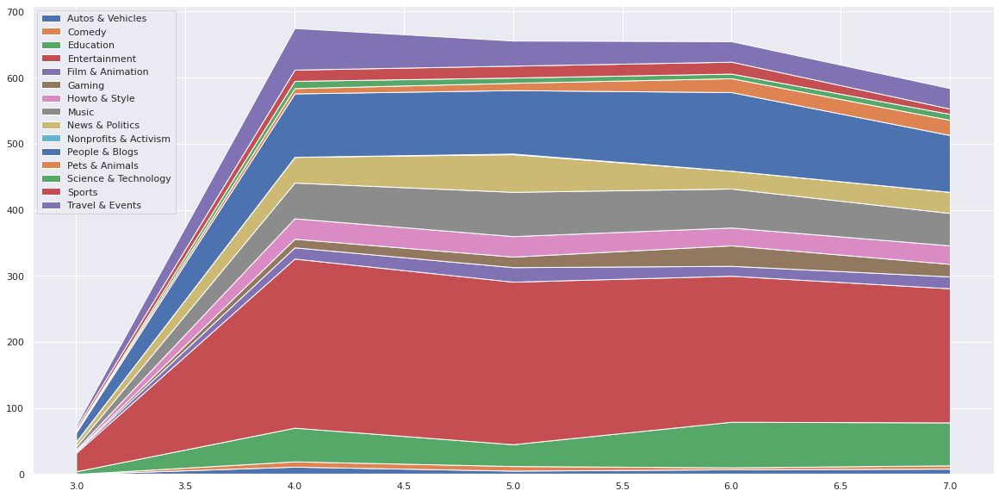

In [446]:
#전체 확인 그래프
%matplotlib inline
plt.figure(figsize=(20,10))
x = df_group_month_ch.columns
for i,k in enumerate(df_group_month_ch.index):
  globals()['y'+str(i)] = df_group_month_ch[df_group_month_ch.index==k].values[0]

# Basic stacked area chart.
plt.stackplot(x,y0,y14,y13,y3,y4,y5,y6,y7,y8,y9,y10,y11,y12,y2,y1, labels=df_group_month_ch.index)
plt.legend(loc='upper left')
plt.show()

In [442]:
#3차원 그래프 시각화
from plotly.offline import plot
import plotly.graph_objs as go
from plotly.offline import plot, iplot


color = {'Entertainment': 'rgb(0,0,0)', 'Sports': 'rgb(255,0,0)', 'Music': 'rgb(0,255,0)', 'People & Blogs': 'rgb(0,0,255)',
       'Science & Technology': 'rgb(255,255,0)', 'Education': 'rgb(128,128,128)', 'Howto & Style': 'rgb(128,0,128)',
       'News & Politics': 'rgb(0,255,255)', 'Gaming': 'rgb(128,0,0)', 'Comedy': 'rgb(0,128,0)', 'Pets & Animals': 'rgb(0,128,128)',
       'Travel & Events': 'rgb(255,0,255)', 'Film & Animation': 'rgb(128,128,0)', 'Autos & Vehicles': 'rgb(0,0,128)',
       'Nonprofits & Activism': 'rgb(192,192,192)'}

data = go.Scatter3d(
    x=df_group_month['category_name'],
    y=df_group_month['published_date'],
    z=df_group_month['video_id'],
    text = ['point #{}'.format(i) for i in df_group_month['channel_id']],
    mode='markers',
    marker=dict(
        size=3,
        color= [color[t] for t in df_group_month['category_name']],
        colorscale='Jet',
        line=dict(
            #color='rgba(217, 217, 217, 0.14)',
            #color='rgb(217, 217, 217)',
            width=0.0
        ),
        opacity=0.8
    ))

layout = go.Layout(
    autosize=True,
    width=1000,
    height=1000,
    margin=go.Margin(
        l=200,
        r=200,
        b=200,
        t=200,
        pad=4
    ),
    #paper_bgcolor='#7f7f7f',
    #plot_bgcolor='#c7c7c7'
)

fig = go.Figure(data, layout=layout)

iplot(fig)

/usr/local/lib/python3.7/dist-packages/plotly/graph_objs/_deprecations.py:410: DeprecationWarning:

plotly.graph_objs.Margin is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.Margin




In [212]:
df_group_month

,published_date,category_name,channel_id,off_channel_total_videos
0,3,Comedy,CHEUL40,282
1,3,Comedy,CHV3i3l,311
2,3,Comedy,CHgBLs7,138
3,3,Comedy,CHyCL5k,436
4,3,Education,CH5YHB-,402
...,...,...,...,...
1675,7,Sports,CHpjOmw,7343
1676,7,Sports,CHqsKWT,2763
1677,7,Sports,CHtm_Qo,39850
1678,7,Sports,CHunsfa,74


In [ ]:
# libraries
import matplotlib.pyplot as plt
import numpy as np
 
# create data
x = df_group_month["published_date"]
y = np.random.rand(5)
z = np.random.rand(5)
 
# pimp your plot with the seaborn style
import seaborn as sns
sns.set_theme()

color = {'Entertainment': 'rgb(0,0,0)', 'Sports': 'rgb(255,0,0)', 'Music': 'rgb(0,255,0)', 'People & Blogs': 'rgb(0,0,255)',
       'Science & Technology': 'rgb(255,255,0)', 'Education': 'rgb(128,128,128)', 'Howto & Style': 'rgb(128,0,128)',
       'News & Politics': 'rgb(0,255,255)', 'Gaming': 'rgb(128,0,0)', 'Comedy': 'rgb(0,128,0)', 'Pets & Animals': 'rgb(0,128,128)',
       'Travel & Events': 'rgb(255,0,255)', 'Film & Animation': 'rgb(128,128,0)', 'Autos & Vehicles': 'rgb(0,0,128)',
       'Nonprofits & Activism': 'rgb(192,192,192)'}

# plot
plt.scatter(x, y, s=z*4000, c=color[df_group_month['category_name']], alpha=0.4, linewidth=6)
 
# Add titles (main and on axis)
plt.xlabel("the X axis")
plt.ylabel("the Y axis")
plt.title("A bubble plot", loc="left")

# show the graph
plt.show()

In [216]:
%matplotlib inline 
x = df_group_month['published_date'] #월별
y = df_group_month['off_channel_total_videos'] #개수

color = {'Entertainment': 'rgb(0,0,0)', 'Sports': 'rgb(255,0,0)', 'Music': 'rgb(0,255,0)', 'People & Blogs': 'rgb(0,0,255)',
       'Science & Technology': 'rgb(255,255,0)', 'Education': 'rgb(128,128,128)', 'Howto & Style': 'rgb(128,0,128)',
       'News & Politics': 'rgb(0,255,255)', 'Gaming': 'rgb(128,0,0)', 'Comedy': 'rgb(0,128,0)', 'Pets & Animals': 'rgb(0,128,128)',
       'Travel & Events': 'rgb(255,0,255)', 'Film & Animation': 'rgb(128,128,0)', 'Autos & Vehicles': 'rgb(0,0,128)',
       'Nonprofits & Activism': 'rgb(192,192,192)'}

plt.scatter(x, y, c=color[df_group_month['category_name']], alpha=0.5, cmap='Spectral')
plt.colorbar()
plt.show()

TypeError: ignored

####(3)월별 top10 채널(비디오개수)

In [518]:
df_group_month

,published_date,category_name,channel_id,video_id
0,3,Comedy,CHEUL40,1
1,3,Comedy,CHV3i3l,1
2,3,Comedy,CHgBLs7,1
3,3,Comedy,CHyCL5k,1
4,3,Education,CH5YHB-,1
...,...,...,...,...
1675,7,Sports,CHpjOmw,1
1676,7,Sports,CHqsKWT,1
1677,7,Sports,CHtm_Qo,4
1678,7,Sports,CHunsfa,1


In [513]:
for i in range(3,8):
  globals()['df_'+str(i)] = df_group_month[df_group_month['published_date']==i].sort_values(by=['video_id'],ascending=False)[:10]

In [514]:
for i in range(3,8):
  globals()['df_label_'+str(i)]=list(globals()['df_'+str(i)]['channel_id'])

In [515]:
for i in range(3,8):
  globals()['df_ratio_'+str(i)]=list(globals()['df_'+str(i)]['video_id']/globals()['df_'+str(i)]['video_id'].sum())

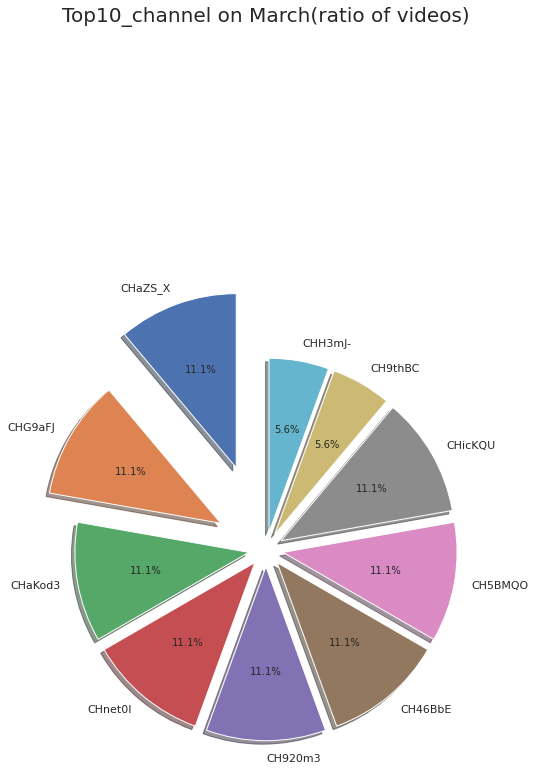

In [516]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_ratio_3,labels=df_label_3,explode=[0.5,0.3,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Top10_channel on March(ratio of videos)",position=(0.5,1.7),fontsize=20)
plt.show()

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning:

Glyph 8 missing from current font.

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning:

Glyph 8 missing from current font.



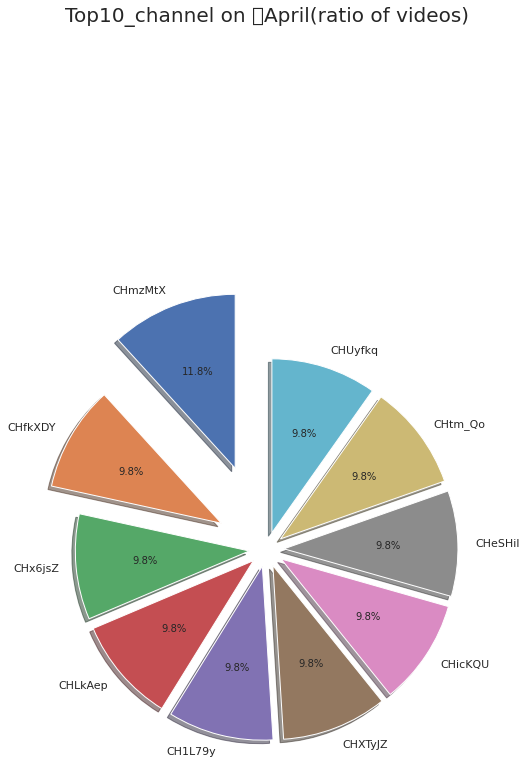

In [517]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_ratio_4,labels=df_label_4,explode=[0.5,0.3,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Top10_channel on April(ratio of videos)",position=(0.5,1.7),fontsize=20)
plt.show()

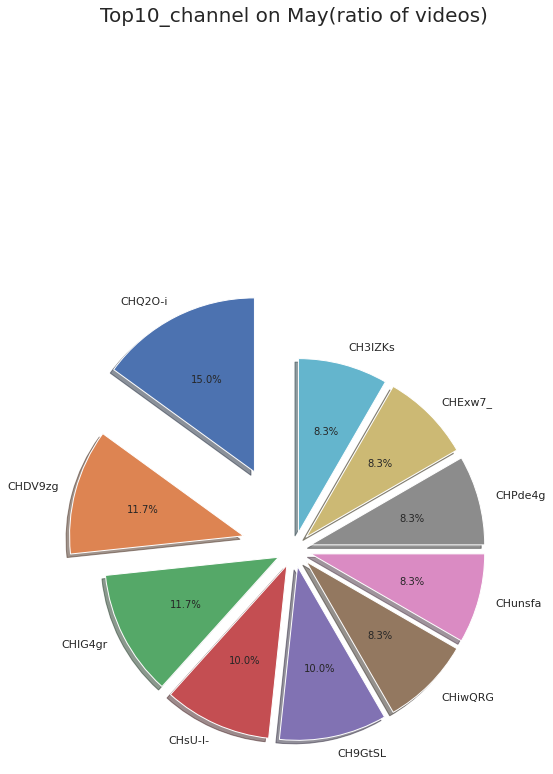

In [519]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_ratio_5,labels=df_label_5,explode=[0.5,0.3,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Top10_channel on May(ratio of videos)",position=(0.5,1.7),fontsize=20)
plt.show()

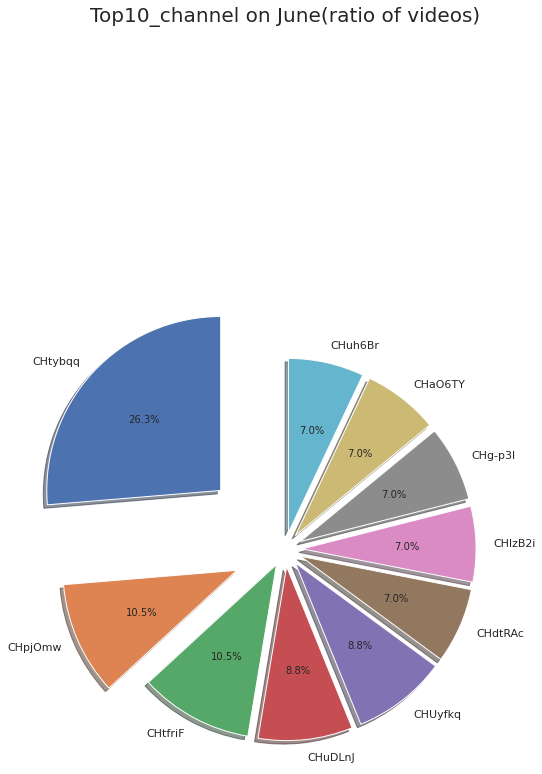

In [520]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_ratio_6,labels=df_label_6,explode=[0.5,0.3,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Top10_channel on June(ratio of videos)",position=(0.5,1.7),fontsize=20)
plt.show()

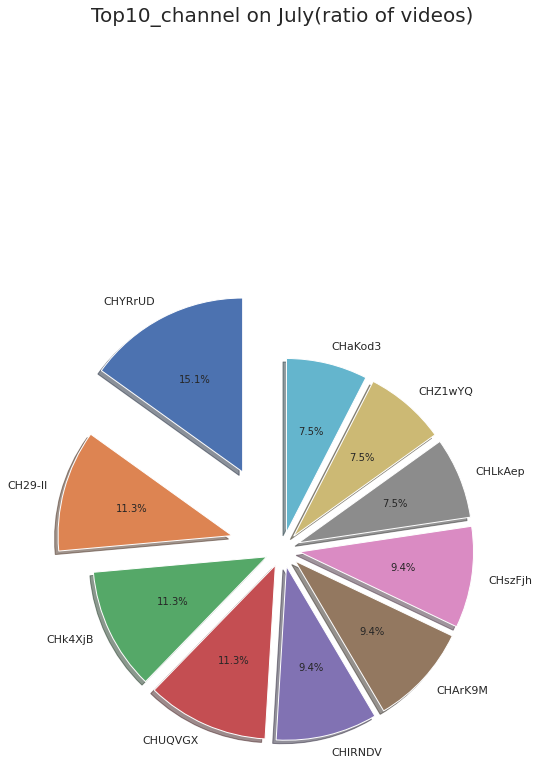

In [521]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_ratio_7,labels=df_label_7,explode=[0.5,0.3,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Top10_channel on July(ratio of videos)",position=(0.5,1.7),fontsize=20)
plt.show()

####(4)주별 top5 채널(비디오개수)
- 스킵

####(5)월별 카테고리별 태그 키워드 순위
스킵

In [228]:
df_month.columns

Index(['video_id', 'channel_id', 'published_date', 'category_name', 'duration',
       'tags', 'description', 'on_trending_date', 'off_trending_date',
       'on_rank', 'off_rank', 'on_views', 'off_views', 'on_likes', 'off_likes',
       'on_dislikes', 'off_dislikes', 'on_comments', 'off_comments',
       'on_channel_subscribers', 'off_channel_subscribers',
       'on_channel_total_views', 'off_channel_total_views',
       'on_channel_total_videos', 'off_channel_total_videos',
       'on_trending_day', 'trending_days', 'duration_group', 'tags_count',
       'des_count', 'hash_count', 'fore_count', 'channel_level',
       'view_deriv_per', 'subscrib_deriv_per', 'like_deriv_per',
       'dislike_deriv_per', 'comment_deriv_per', 'view_ratio', 'trend_ratio',
       'like_ratio'],
      dtype='object')

In [265]:
df_month = copy.deepcopy(df_final)
#업로드 데이터에서 월별 날짜로 변경
df_month['published_date'] = df_month['published_date'].apply(lambda x: x.month)
#월별 카테고리별 채널별 조회수 그룹화 - 동일 월,카테고리,채널이 있을 경우 높은 값을 채택
df_month = df_month.groupby(['published_date','category_name','tags'],as_index=False).count()[['published_date','category_name','tags']]

In [266]:
df_month['tags']= df_month['tags'].apply(lambda x: x.split('|') if type(x)!=int else 0)

In [267]:
df_month_3=df_month[df_month['published_date']==3]

In [269]:
df_month_3[df_month['category_name']=='Comedy'].groupby(['published_date','category_name']).sum()['tags']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



published_date  category_name
3               Comedy           [#깨방정, #정승빈, #몰카, #미녀, #개그맨, #존잘남, #존예녀, #디스코,...
Name: tags, dtype: object

In [259]:
df_month_3.groupby(['published_date','category_name']).sum()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: FutureWarning:

Dropping invalid columns in DataFrameGroupBy.add is deprecated. In a future version, a TypeError will be raised. Before calling .add, select only columns which should be valid for the function.



Empty DataFrame
Columns: []
Index: [(3, Comedy), (3, Education), (3, Entertainment), (3, Film & Animation), (3, Gaming), (3, Howto & Style), (3, Music), (3, News & Politics), (3, People & Blogs), (3, Pets & Animals), (3, Science & Technology), (3, Sports)]

In [255]:
a= '#깨방정|#정승빈|#몰카|#미녀'
b= '러시아 물가|러시아 집|무르만스크|ㄹ|러시아 여행'
a+b

'#깨방정|#정승빈|#몰카|#미녀러시아 물가|러시아 집|무르만스크|ㄹ|러시아 여행'

####(6) 카테고리 분포 수

In [272]:
df_group_all =df_final.groupby('category_name').count()

In [275]:
df_group_all.index

Index(['Autos & Vehicles', 'Comedy', 'Education', 'Entertainment',
       'Film & Animation', 'Gaming', 'Howto & Style', 'Music',
       'News & Politics', 'Nonprofits & Activism', 'People & Blogs',
       'Pets & Animals', 'Science & Technology', 'Sports', 'Travel & Events'],
      dtype='object', name='category_name')

In [274]:
df_group_all['video_id']

category_name
Autos & Vehicles          31
Comedy                   167
Education                 65
Entertainment            954
Film & Animation          74
Gaming                    80
Howto & Style            119
Music                    234
News & Politics          162
Nonprofits & Activism      1
People & Blogs           411
Pets & Animals            65
Science & Technology      36
Sports                   222
Travel & Events           23
Name: video_id, dtype: int64

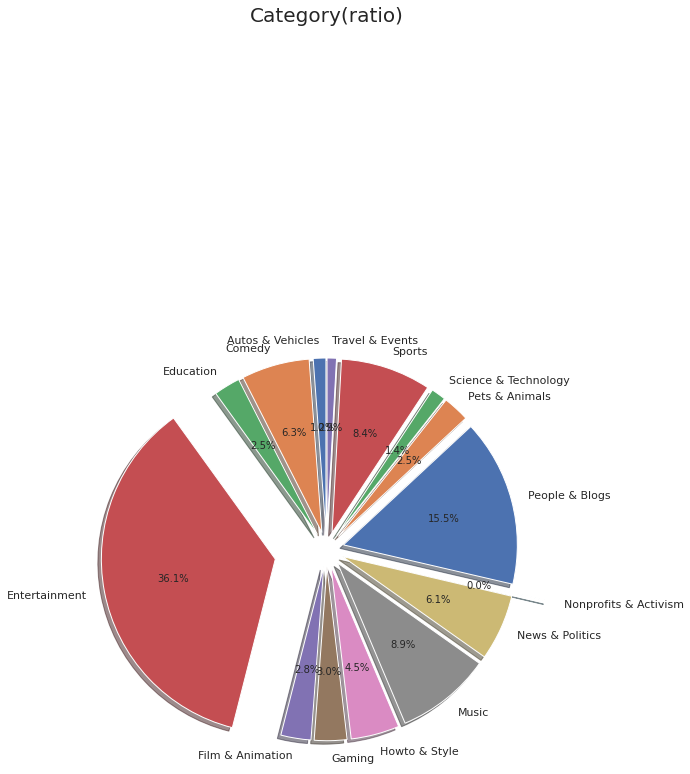

In [282]:
#카테고리별 영상수 (1위 엔터테이먼트, 2위 브이로그, 3위 음악, 4위 스포츠)
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_group_all['video_id'],labels=df_group_all.index,explode=[0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Category(ratio)",position=(0.5,1.7),fontsize=20)
plt.show()

In [284]:
#인기동영상 카테고리별 조회수 합계
df_group_all =df_final.groupby('category_name').sum()['off_views']

In [286]:
df_group_all.index

Index(['Autos & Vehicles', 'Comedy', 'Education', 'Entertainment',
       'Film & Animation', 'Gaming', 'Howto & Style', 'Music',
       'News & Politics', 'Nonprofits & Activism', 'People & Blogs',
       'Pets & Animals', 'Science & Technology', 'Sports', 'Travel & Events'],
      dtype='object', name='category_name')

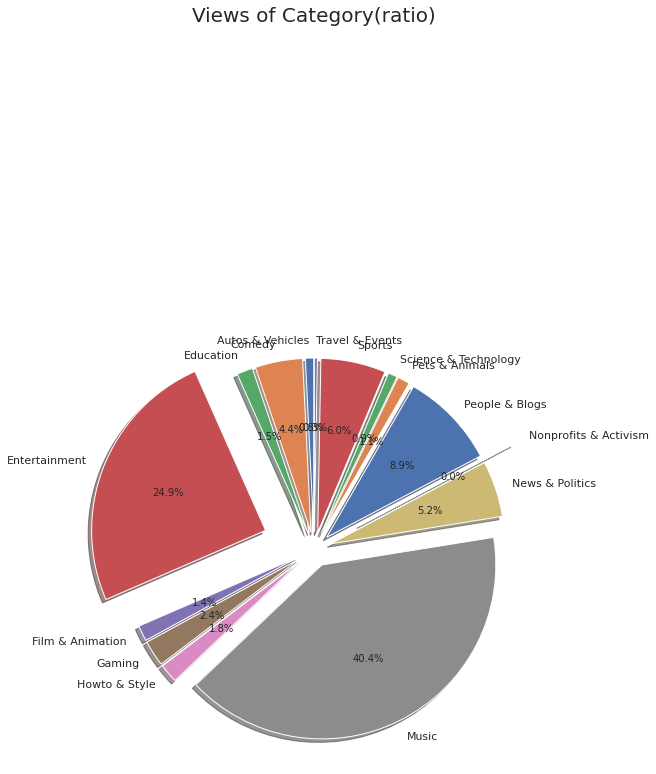

In [288]:
#카테고리별 영상조회수 (1위 음악, 2위 엔터테이먼트, 3위 브이로그, 4위 여행)
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,8))
plt.pie(df_group_all,labels=df_group_all.index,explode=[0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Views of Category(ratio)",position=(0.5,1.7),fontsize=20)
plt.show()

####(7) 영상 길이 분포

In [300]:
df_final.groupby('duration_group').count()['video_id'].index

Index(['over hour', 'shorts', 'under 10', 'under 20', 'under 40',
       'under hour'],
      dtype='object', name='duration_group')

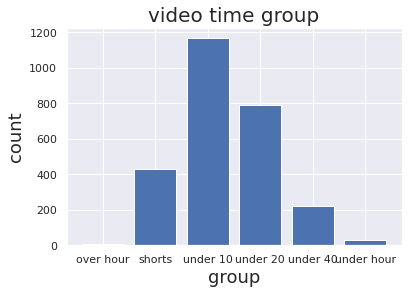

In [301]:
plt.bar(df_final.groupby('duration_group').count()['video_id'].index, df_final.groupby('duration_group').count()['video_id'])
plt.title('video time group', fontsize=20)
plt.xlabel('group', fontsize=18)
plt.ylabel('count', fontsize=18)
plt.show()


####(8) 태그 수 , 디스크립션 글자 수 max, 평균 확인
- 태그 : max 132개, 평균 18개
- 디스크립션 글자수 : max 4848개, 평균 374개

In [307]:
print(df_final['tags_count'].max())
print(df_final['tags_count'].mean())

132
18.16263237518911


In [306]:
print(df_final['des_count'].max())
print(df_final['des_count'].mean())

4848
374.93154311649016


####(9) 비공개 채널 특성 파악
- 총 64개의 채널
- 공식 채널 및 기획사 경우가 많다
- 엔터테이먼트, 스포츠 ( 기획사, 뉴스채널) 이 주를 이룸

In [310]:
df_final[df_final['off_channel_subscribers']==0].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3,3,3
Comedy,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1
Entertainment,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,28,0,28,28,28,28,28,28
Film & Animation,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3,3,3
Gaming,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,0,4,4,4,4,4,4
Howto & Style,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1
Music,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,0,3,3,4,4,4,3
News & Politics,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1
People & Blogs,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,4,0,4,4,4,4,4,4


####(10) 날짜 관련
- 평일, 주말 간 인기동영상 카테고리 분포
  - 평일:1794개, 주말: 850개 (단순 계산으로 주말이 하루당 인기동영상 등록비율이 높다)
  - 평일 : 1위 엔터(32%), 2위 브이로그(15.8%), 3위 음악(10%), 4위 스포츠(9%), 5위 코미디(6.8%)
  - 주말 : 1위 엔터(44%), 2위 브이로그(14.8%), 3위 스포츠(6.7%), 4위 뉴스(5.7%), 5위 음악(5.5%)

In [317]:
#평일 인기동영상
df_final[df_final['on_trending_day']=='weekday'].groupby('category_name').count()['video_id']

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.226310,1.059086,1.226310,1.226310,1.170569,1.226310,1.226310,1.226310
Comedy,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446,6.744705,6.800446,6.800446,6.800446,6.800446,6.800446,6.800446
Education,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103,2.564103
Entertainment,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,32.274247,31.549610,32.051282,32.051282,32.274247,32.274247,32.274247,32.051282
Film & Animation,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.065775,3.010033,2.954292,3.010033,3.010033,3.010033,3.065775,3.065775,3.010033
Gaming,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.898551,2.787068,2.731327,2.731327,2.898551,2.898551,2.898551,2.731327
Howto & Style,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498,4.849498
Music,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.423634,10.312152,10.200669,10.200669,10.144928,10.423634,10.423634,10.200669
News & Politics,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.298774,6.2987

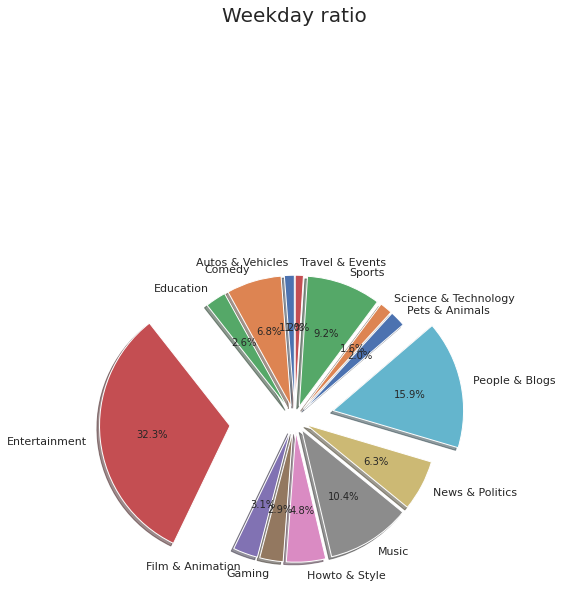

In [329]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,6))
plt.pie(df_final[df_final['on_trending_day']=='weekday'].groupby('category_name').count()['video_id'],labels=df_final[df_final['on_trending_day']=='weekday'].groupby('category_name').count()['video_id'].index,explode=[0.1,0.1,0.1,0.5,0.1,0.1,0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Weekday ratio",position=(0.5,1.7),fontsize=20)
plt.show()

In [318]:
#주말 인기동영상
df_final[df_final['on_trending_day']=='weekend'].groupby('category_name').count()/850*100

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824,1.058824
Comedy,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118,5.294118
Education,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294
Entertainment,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,44.117647,42.352941,43.176471,43.176471,44.117647,44.117647,44.117647,43.176471
Film & Animation,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294,2.117647,2.235294,2.235294,2.235294,2.235294,2.235294,2.235294
Gaming,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118,3.058824,3.294118,3.294118,3.294118,3.294118,3.294118,3.294118
Howto & Style,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706,3.647059,3.764706,3.764706,3.764706,3.764706,3.764706,3.764706
Music,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.529412,5.294118,5.529412,5.529412,5.294118,5.529412,5.529412,5.529412
News & Politics,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.764706,5.647059,5.764706,5.764706,5.764706,5.764706,5.764706,5

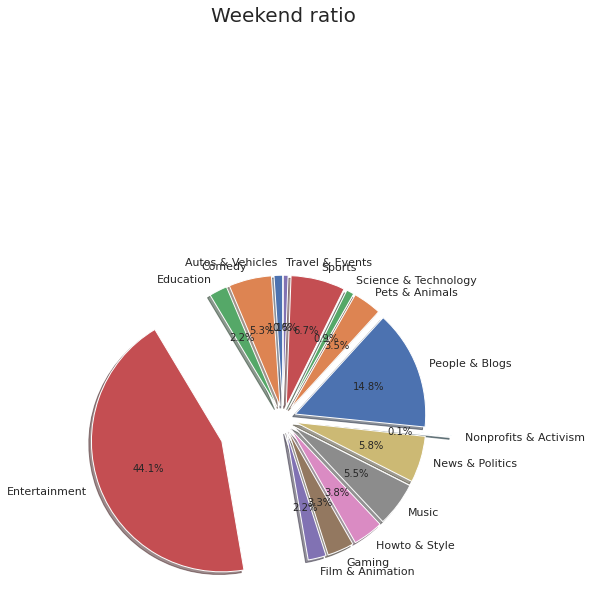

In [331]:
import matplotlib.pyplot as plt
%matplotlib inline 
plt.figure(figsize=(15,6))
plt.pie(df_final[df_final['on_trending_day']=='weekend'].groupby('category_name').count()['video_id'],labels=df_final[df_final['on_trending_day']=='weekend'].groupby('category_name').count()['video_id'].index,explode=[0.1,0.1,0.1,0.5,0.1,0.1,0.1,0.1,0.1,0.3,0.1,0.1,0.1,0.1,0.1],shadow=True,startangle=90,autopct='%1.1f%%')
plt.title("Weekend ratio",position=(0.5,1.7),fontsize=20)
plt.show()

####(11) 영상 내용에 대한 평가지표 활용
- 좋아요,싫어요 비율에 따른 분포확인(호감/중립/불호)
- 구독자 등급 별로 카테고리 분포

In [342]:
print(df_final['like_ratio'].min())
print(df_final['like_ratio'].max())

0.08176795580110498
1447.3949579831933


In [ ]:
#싫어요 수가 더 많은 영상 = 논란을 빚은 BJ 다수
df_final[df_final['like_ratio']<1]

In [ ]:
#좋아요 수가 많은 영상 == 아이돌, 연예인 영상 /음악,브이로그 순
df_final.sort_values('like_ratio',ascending=False)

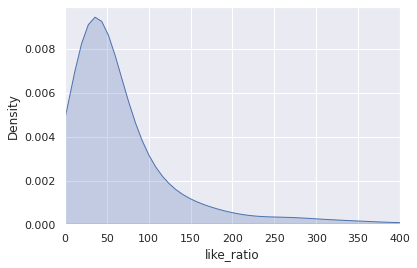

In [364]:
# like_ratio 비율 확인
plt.xlim([0, 400])
sns.kdeplot(df_final['like_ratio'],shade=True)

In [354]:
#카테고리별 유튜브 구독자 구분
df_final.groupby(['category_name','channel_level']).count()

video_id  channel_id  published_date  \
category_name         channel_level                                         
Autos & Vehicles      bronze                9           9               9   
                      orpal                 3           3               3   
                      silver               19          19              19   
Comedy                bronze               19          19              19   
                      diamond               3           3               3   
                      gold                 74          74              74   
                      orpal                 1           1               1   
                      silver               70          70              70   
Education             gold                 21          21              21   
                      silver               44          44              44   
Entertainment         bronze               96          96              96   
                      diamond              15          15              15   
                      gold                330         330             330   
                      orpal                31          31              31   
                      silver              482         482             482   
Film & Animation      bronze                9           9               9   
                      gold                 24          24              24   
                      orpal                 3           3               3   
                      silver               38          38              38   
Gaming                bronze               12          12              12   
                      gold                 22          22              22   
                      orpal                 5           5               5   
                      silver               41          41              41   
Howto & Style         bronze               18          18              18   
                      gold                 15          15              15   
                      orpal                 2           2               2   
                      silver               84          84              84   
Music                 bronze               30          30              30   
                      diamond              42          42              42   
                      gold                100         100             100   
                      orpal                20          20              20   
                      silver               42          42              42   
News & Politics       bronze               24          24              24   
                      gold                 53          53              53   
                      orpal                 2           2               2   
                      silver               83          83              83   
Nonprofits & Activism gold                  1           1               1   
People & Blogs        bronze               73          73              73   
                      gold                 65          65              65   
                      orpal                16          16              16   
                      silver              257         257             257   
Pets & Animals        bronze                4           4               4   
                      gold                 16          16              16   
                      orpal                 2           2               2   
                      silver               43          43              43   
Science & Technology  bronze                6           6               6   
                      diamond               2           2               2   
                      gold                  8           8               8   
                      silver               20          20              20   
Sports                bronze               50          50              50   
                      gold       

In [356]:
#다이아몬드 레벨 분포 // 1위 음악
df_final[df_final['channel_level']=='diamond'].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Comedy,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3
Entertainment,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15
Music,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42
Science & Technology,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,0,2,2,2


In [357]:
#골드 레벨 분포 // 1위 엔터테이먼트
df_final[df_final['channel_level']=='gold'].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Comedy,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74,74
Education,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21,21
Entertainment,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330,330
Film & Animation,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,23,24,23,23,23,24,24,23
Gaming,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22,22
Howto & Style,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15,15
Music,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,100,97,97,100,100,100,97
News & Politics,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53,53
Nonprofits & Activism,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1


In [358]:
#실버 레벨 분포 // 1위 엔터 2위 브이로그
df_final[df_final['channel_level']=='silver'].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,18,19,19,19
Comedy,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70,70
Education,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44,44
Entertainment,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,482,471,471,482,482,482,471
Film & Animation,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38,38
Gaming,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,41,38,38,41,41,41,38
Howto & Style,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84,84
Music,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,42,40,42,42,42
News & Politics,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83,83


In [359]:
#브론즈 레벨 분포 // 1위 엔터
df_final[df_final['channel_level']=='bronze'].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
Comedy,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19,19
Entertainment,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,96,95,95,96,96,96,95
Film & Animation,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9,9
Gaming,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12,12
Howto & Style,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18,18
Music,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,30,29,30,30,30
News & Politics,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24,24
People & Blogs,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,73,71,71,71,73,73,71


In [360]:
#오팔 레벨 분포 // 1위 엔터
df_final[df_final['channel_level']=='orpal'].groupby('category_name').count()

,video_id,channel_id,published_date,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
category_name,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Autos & Vehicles,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3,3,3
Comedy,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1
Entertainment,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,31,3,31,31,31,31,31,31
Film & Animation,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,3,0,3,3,3,3,3,3
Gaming,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,5,1,5,5,5,5,5,5
Howto & Style,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2,2,2,2,2
Music,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,20,16,19,19,16,20,20,19
News & Politics,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,1,2,2,2,2,2,2
People & Blogs,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,12,16,16,16,16,16,16


####(12) 변화량 시각화
- [(인기동영상 후 - 인기동영상 전)/인기동영상 유지기간] / 인기동영상 전 조회수
- 'view_deriv_per'
- 'subscrib_deriv_per'
- 'like_deriv_per'
- 'dislike_deriv_per'
- 'comment_deriv_per'

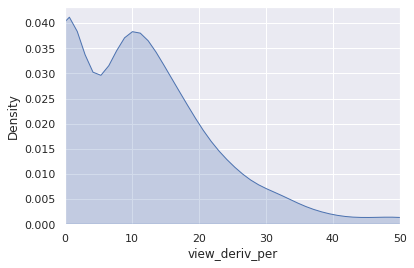

In [363]:
# view_deriv_per 비율 확인
plt.xlim([0, 50])
sns.kdeplot(df_final['view_deriv_per'],shade=True)

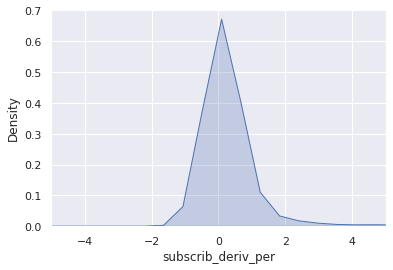

In [366]:
# subscrib_deriv_per 비율 확인
plt.xlim([-5, 5])
sns.kdeplot(df_final['subscrib_deriv_per'],shade=True)

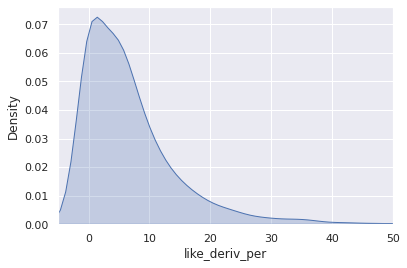

In [368]:
# like_deriv_per 비율 확인
plt.xlim([-5, 50])
sns.kdeplot(df_final['like_deriv_per'],shade=True)

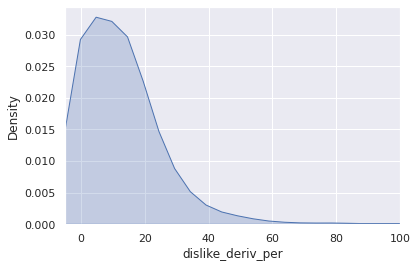

In [370]:
# dislike_deriv_per 비율 확인
plt.xlim([-5, 100])
sns.kdeplot(df_final['dislike_deriv_per'],shade=True)

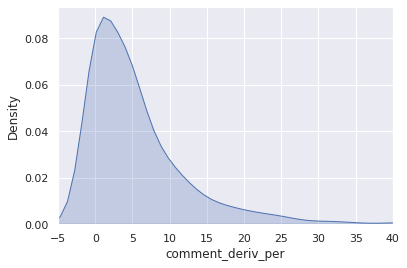

In [372]:
# comment_deriv_per 비율 확인
plt.xlim([-5, 40])
sns.kdeplot(df_final['comment_deriv_per'],shade=True)

####(13) 트렌드 분석
- 비교적 적은 비디오개수 (10개 미만의 동영상 수)
- 구독자수, 그러나 조회수가 높거나 구독자 증가율이 높음
- 해당 비디오조회수/전체 조회수 사용=비율이 높으면서 비디오 개수가 낮으나 증가율이 높았다 하면 트렌드
- 분석결과, 먹방, 연예인(임영웅), 마인크래프트, 아이돌,감동영상, 예능 과 같이 트렌드를 띄는 것으로 분석
- 가끔 조회수가 0이어도 캠페인 영상이 인기영상에 포함되는듯하다.

In [397]:
#현재 채널의 동영상이 10개 미만, 구독자 변화수 오름차순으로 정렬
df_final[df_final['off_channel_total_videos']<10].sort_values('subscrib_deriv_per',ascending=False)

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio
86,V1Cfz,CHkkWd0,2021-04-27,People & Blogs,00:07:20,0,0,2021-04-29,2021-05-01,4,13,276767,836443,18856,36424,301,767,3036,4514,68700,144000,75036,827352,1,2,weekday,3,under 10,0,0,0,0,silver,67.406398,36.535662,31.056428,51.605759,16.227492,1.010988,4.136760e+05,47.488918
1314,VUWya,CHF8W68,2021-05-29,People & Blogs,00:09:14,천뚱|전참시|먹짱,부족하지만 앞으로 잘 부탁드립니다!#천뚱 #짜파게티 #먹방,2021-06-01,2021-06-02,34,38,176598,374546,7230,12501,91,179,1267,2036,28600,46900,79032,186428,1,1,weekday,2,under 10,3,32,3,0,bronze,56.044802,31.993007,36.452282,48.351648,30.347277,2.009065,1.864280e+05,69.837989
302,V5zvX,CHoe-0E,2021-06-17,Sports,00:03:43,김종국|짐종국|런닝맨|미우새|헬스|운동|유재석|하하|이광수|송지효|스포츠|축구|김계...,제가 감히 ㅎ 유튜브 를 오픈했습니다 ㅎㅎ 자격증 이라고는 이 몸땡이 뿐인 채널 G...,2021-06-19,2021-06-23,3,33,2175778,7556686,117167,265586,821,3544,18979,42011,528000,1100000,385247,6957273,1,1,weekend,5,under 10,15,208,3,3,gold,49.461921,21.666667,25.334608,66.333739,24.271036,1.086156,6.957273e+06,74.939616
781,VGwo_,CHTmrCB,2021-07-06,Entertainment,00:06:23,사회실험|실험카메라|감동영상|몰카|몰래카메라|원더맨|다리|한강|생명|희망|socia...,ENG) 삶을 끝내려고 하는 사람을 본다면? | 사회실험 | 실험카메라힘들고 지친...,2021-07-08,2021-07-09,21,26,208246,415984,10945,23781,212,410,1126,1840,16100,23000,1120703,1368137,9,9,weekday,2,under 10,22,342,5,120,bronze,49.878029,21.428571,58.638648,46.698113,31.705151,0.304051,1.520152e+05,58.002439
151,V2uYL,CHkkWd0,2021-04-29,People & Blogs,00:03:27,0,0,2021-04-30,2021-05-03,1,33,236287,912241,20931,43189,231,645,0,0,110000,184000,295398,1999077,2,2,weekday,4,under 10,0,0,0,0,silver,71.518323,16.818182,26.584970,44.805195,NaN,0.456331,9.995385e+05,66.959690
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
494,VAdX3,CHkkWd0,2021-05-22,People & Blogs,00:07:04,0,평범한 주말... 하영이에게 집을 지어달라고 했어요...^^집에서는 뭘 하고 노는지...,2021-05-24,2021-05-24,23,23,585948,585948,38976,38976,412,412,2126,2126,279000,279000,5260039,5260039,6,6,weekday,1,under 10,0,69,0,0,silver,0.000000,0.000000,0.000000,0.000000,0.000000,0.111396,8.766732e+05,94.601942
531,VBOM1,CHx_kYu,2021-04-12,People & Blogs,00:00:24,브레이브걸스|Brave Girls|민영|은지|유나|유정|minyoung|eunji|...,[ OFFICIAL SITE]▶Official Twitter : https://tw...,2021-04-14,2021-04-14,20,20,97641,97641,0,0,0,0,2052,2052,39600,39600,55316,55316,2,2,weekday,1,shorts,23,298,6,228,bronze,0.000000,0.000000,NaN,NaN,0.000000,1.765149,2.765800e+04,NaN
760,VGV76,CHhg51l,2021-04-08,Sports,00:12:36,페루자|월드컵|손흥민|이영표|나무위키|청춘fc|어쩌다fc|뭉쳐야쏜다|축구|하이라이트,“월드컵 한 골을 위해 평생을...”본격 희로애락 나무위키 읽기!다시 쓰는 정환사!...,2021-04-11,2021-04-11,41,41,99245,99245,2788,2788,32,32,758,758,27500,27500,132176,132176,3,3,weekend,1,under 20,10,278,3,31,bronze,0.000000,0.000000,0.000000,0.000000,0.000000,0.750855,4.405867e+04,87.125000
1064,VNobj,CH47HAk,2021-04-20,People & Blogs,00:04:32,0,0,2021-04-23,2021-04-23,34,34,522282,522282,25279,25279,9748,9748,11838,11838,1210000,1210000,412705,412705,1,1,weekday,1,under 10,0,0,0,0,gold,0.000000,0.000000,0.000000,0.000000,0.000000,1.265509,4.127050e+05,2.593250


In [391]:
#구독자 변화율이 상위 20%
df_final['subscrib_deriv_per'].quantile(q=0.8, interpolation='nearest')

0.3289473684210526

In [392]:
#조회수 변화율이 상위 20%
df_final['view_deriv_per'].quantile(q=0.8, interpolation='nearest')

19.53819527932373

In [393]:
#구독자,조회수 변화율 모두 상위 10%
trend= df_final[df_final['subscrib_deriv_per']>=0.328]
trend= trend[trend['view_deriv_per']>=19.5] 

In [ ]:
trend[trend['off_channel_total_videos']<20]

#Q2.인기동영상의 기준을 찾자.
- 새로운 지표, 호응도와 상관관계 설명
- Minmum 조회수를 확인하여 최저 기준확인 (최저 : 53297)
- 업로드 날짜와 인기동영상 선정 일자 비교후 조회수로 나누어 증가 속도 유추
  - 하루에 50만뷰를 찍을 정도일때 선정되는 경우가 가장 많다.
  - 최저는 하루에 18000명정도가 조회
  - 1시간에 2만명, 10분에 3500명 가량이 시청할 정도의 파급력
- 해시태그 수 혹은 디스크립션 외국어 포함 글자수
- 채널의 비디오개수(스테디한지 확인)- 적다 트렌디(특징파악), 많다 스테디하다(특징파악)
- 구독자수를 공개하는 게 더 좋음


In [ ]:
#최저 기준
df_final.sort_values('on_views')

In [400]:
#업로드 날짜와 인기동영상 선정 일자 비교후 조회수로 나누어 증가 속도
df_final['on_trending_date'] = pd.to_datetime(df_final['on_trending_date']).dt.date
df_final['published_date'] = pd.to_datetime(df_final['published_date']).dt.date

In [408]:
#업로드날짜,선정날짜 차이
df_final['diff_on']= (df_final['on_trending_date']-df_final['published_date']).dt.days

In [410]:
df_final['pace'] = df_final['on_views']/df_final['diff_on']

In [ ]:
#pace를 통한 데이터 확인
df_final.sort_values('pace')

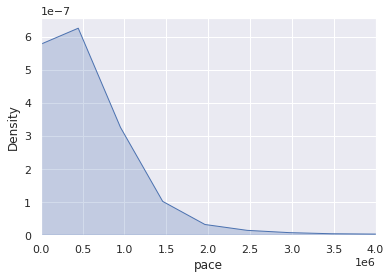

In [425]:
# pace밀도 확인
plt.xlim([0,4000000])
sns.kdeplot(df_final['pace'],shade=True)

In [ ]:
#외국어 글자 수로 확인 - 크게 관련이 없어보임
df_final.sort_values('fore_count',ascending=False)

In [ ]:
#외국어 글자 수로 확인 - 크게 관련이 없어보임
df_final.sort_values('hash_count',ascending=False)

In [496]:
#구독자수 대비 조회수가 높으면?
df_final['view_sub']=df_final['on_views']/df_final['on_channel_subscribers']

In [506]:
df_final=df_final.replace([np.inf, -np.inf], np.nan)
df_final=df_final.fillna(0)

In [507]:
df_final.sort_values('view_sub',ascending=False)

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio,cluster,view_sub
1205,VR_XB,CHuKdaT,2021-05-10,Music,00:03:13,NCT DREAM|Hot Sauce - The 1st Album|고래 Dive In...,Provided to YouTube by SM Entertainment고래 Dive...,2021-05-12,2021-05-12,38,38,921503,921503,146162,146162,314,314,83,83,499,499,75961356,75961356,80,80,weekday,1,under 10,3,263,0,208,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.012131,9.495169e+05,465.484076,0,1846.699399
1186,VRFMm,CHvolP1,2021-07-19,Music,00:03:30,JANG BEOM JUNE|장범준|Go Back|첫 번째 '고백'|고백,Provided to YouTube by Kakao EntertainmentGo B...,2021-07-22,2021-07-22,24,24,121441,121441,2279,2279,47,47,0,0,90,90,109472682,109472682,51,51,weekday,1,under 10,5,280,0,201,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.001109,2.146523e+06,48.489362,0,1349.344444
417,V8khw,CHuKdaT,2021-06-28,Music,00:03:39,NCT DREAM|Hello Future - The 1st Album Repacka...,Provided to YouTube by SM Entertainment오르골 Lif...,2021-06-30,2021-07-01,26,36,675268,913358,86542,95838,204,307,71,74,546,548,108220366,109403593,95,95,weekday,2,under 10,3,277,0,214,orpal,17.629297,0.183150,5.370803,25.245098,2.112676,0.008349,1.151617e+06,312.175896,0,1236.754579
1473,VYdD2,CH2Q9aM,2021-05-03,People & Blogs,00:00:08,0,0,2021-05-05,2021-05-07,13,48,2744095,3562216,39459,51312,517,711,9678,11388,2320,3000,2360146,4031109,4,4,weekday,3,shorts,0,0,0,0,orpal,9.937958,9.770115,10.012925,12.508059,5.889647,0.883681,1.007777e+06,72.168776,0,1182.799569
1383,VWMH5,CHuKdaT,2021-06-28,Music,00:03:29,NCT DREAM|Hello Future - The 1st Album Repacka...,Provided to YouTube by SM EntertainmentBungee ...,2021-06-30,2021-06-30,38,38,376921,376921,52233,52233,99,99,30,30,546,546,108220366,108220366,95,95,weekday,1,under 10,3,261,0,208,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.003483,1.139162e+06,527.606061,0,690.331502
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1098,VOpLb,CH5f97D,2021-04-20,Autos & Vehicles,00:01:01,Hyundai|HyundaiWorldwide|Car|Hyundai company,"🌎On Earth Day 2021, we shed light on the peopl...",2021-04-22,2021-04-22,28,28,2172257,2172257,313206,313206,389,389,8774,8774,0,0,877710635,877710635,540,540,weekday,1,shorts,4,841,8,684,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.002475,1.625390e+06,805.156812,0,0.000000
2242,VqW34,CHb_-Xu,2021-04-19,People & Blogs,00:00:48,하루세끼|만원한끼|cooking asmr|korean recipe|easy reci...,안녕하세요 ㅎㄹㅅㄲ 입니다.오늘은 바나나 덕후라면 좋아하는 바나나 팬케이크 만들기입...,2021-04-22,2021-04-22,30,30,207167,207167,4375,4375,208,208,135,135,0,0,6912211,6912211,42,42,weekday,1,shorts,14,374,0,128,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.029971,1.645765e+05,21.033654,0,0.000000
1926,Viqbx,CHtybqq,2021-06-13,Sports,00:15:01,EURO|EURO2020|football|tvn|xtvn|네덜란드|메시|박지성|배성...,⚽ EURO 2020 ⚽ 네덜란드 VS 우크라이나 - H/L-------------...,2021-06-15,2021-06-15,36,36,635876,635876,4055,4055,168,168,1250,1250,0,0,3457393,3457393,89,89,weekday,1,under 20,26,387,0,69,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.183918,3.884711e+04,24.136905,0,0.000000
1642,VbcKW,CHtybqq,2021-06-13,Sports,00:09:16,EURO|EURO2020|football|tvn|xtvn|메시|박지성|배성재|손흥민...,⚽ EURO 2020 ⚽ 덴마크 VS 핀란드 - H/L (전반전)----------...,2021-06-14,2021-06-14,23,23,357014,357014,2124,2124,56,56,1222,1222,0,0,1646131,1646131,84,84,weekday,1,under 10,25,390,0,69,orpal,0.000000,0.000000,0.000000,0.000000,0.000000,0.216881,1.

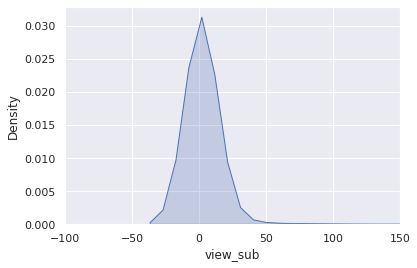

In [510]:
# 구독자 대비 조회수 밀도 확인
plt.xlim([-100,150])
sns.kdeplot(df_final['view_sub'],shade=True)

#Clustering

In [447]:
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

In [467]:
#데이터 다듬기
df_final=df_final.fillna(0)

df_final.drop(['video_id', 'channel_id', 'published_date', 'category_name', 'duration','tags', 'description', 'on_trending_date', 'off_trending_date','on_trending_day','channel_level','duration_group'],inplace=True,axis=1)

In [475]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2644 entries, 0 to 2643
Data columns (total 29 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   on_rank                   2644 non-null   int64  
 1   off_rank                  2644 non-null   int64  
 2   on_views                  2644 non-null   int64  
 3   off_views                 2644 non-null   int64  
 4   on_likes                  2644 non-null   int64  
 5   off_likes                 2644 non-null   int64  
 6   on_dislikes               2644 non-null   int64  
 7   off_dislikes              2644 non-null   int64  
 8   on_comments               2644 non-null   int64  
 9   off_comments              2644 non-null   int64  
 10  on_channel_subscribers    2644 non-null   int64  
 11  off_channel_subscribers   2644 non-null   int64  
 12  on_channel_total_views    2644 non-null   int64  
 13  off_channel_total_views   2644 non-null   int64  
 14  on_chann

In [476]:
df_final.columns

Index(['on_rank', 'off_rank', 'on_views', 'off_views', 'on_likes', 'off_likes',
       'on_dislikes', 'off_dislikes', 'on_comments', 'off_comments',
       'on_channel_subscribers', 'off_channel_subscribers',
       'on_channel_total_views', 'off_channel_total_views',
       'on_channel_total_videos', 'off_channel_total_videos', 'trending_days',
       'tags_count', 'des_count', 'hash_count', 'fore_count', 'view_deriv_per',
       'subscrib_deriv_per', 'like_deriv_per', 'dislike_deriv_per',
       'comment_deriv_per', 'view_ratio', 'trend_ratio', 'like_ratio'],
      dtype='object')

In [480]:
df_final.drop(['view_deriv_per','subscrib_deriv_per', 'like_deriv_per', 'dislike_deriv_per','comment_deriv_per', 'view_ratio', 'trend_ratio', 'like_ratio'],inplace=True,axis=1)

In [481]:
#표준화
df_final= StandardScaler().fit_transform(df_final)

In [482]:
pca = PCA(3) # 주성분을 몇개로 할지 결정
printcipalComponents = pca.fit_transform(df_final)
PCAdf = pd.DataFrame(data=printcipalComponents, columns = ['principal component1', 'principal component2','principal component3'])#,'principal component3']
kmeans = KMeans(n_clusters = 3,random_state = 42, max_iter=1000,init='k-means++',n_init=10)
prediction = kmeans.fit(PCAdf)
labels1 = kmeans.labels_

In [483]:
#표준화 하고 pca 3개 클러스터링
from plotly.offline import plot
import plotly.graph_objs as go
from plotly.offline import plot, iplot

color = ['rgb(102,153,255)', 'rgb(204,000,000)','rgb(102,255,153)']

for i in range(3):
    globals()['data{}'.format(i)] = go.Scatter3d(
        x=printcipalComponents[[labels1==i]][:,0],
        y=printcipalComponents[[labels1==i]][:,1],
        z=printcipalComponents[[labels1==i]][:,2],
        text = ['point #{}'.format(i) for i in range(printcipalComponents.shape[0])],
        mode='markers',
        marker=dict(
            size=3,
            color=color[i],
            colorscale='Jet',
            line=dict(
                #color='rgba(217, 217, 217, 0.14)',
                #color='rgb(217, 217, 217)',
                width=0.0
            ),
            opacity=0.8
        )
    )

layout = go.Layout(
    autosize=True,
    width=500,
    height=500,
    margin=go.Margin(
        l=50,
        r=50,
        b=100,
        t=100,
        pad=4
    ),
    #paper_bgcolor='#7f7f7f',
    #plot_bgcolor='#c7c7c7'
)

fig = go.Figure(data=[data0,data1,data2], layout=layout)

iplot(fig)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:12: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a di

In [485]:
len(labels1)

2644

In [488]:
df_final['cluster'] = labels1

In [491]:
#구독자,조회수 변화율 모두 상위 10%
trend= df_final[df_final['subscrib_deriv_per']>=0.328]
trend= trend[trend['view_deriv_per']>=19.5] 

In [ ]:
#트렌디한 자료 확인
trend[trend['off_channel_total_videos']<20]

In [494]:
df_final[df_final['cluster']==1]

,video_id,channel_id,published_date,category_name,duration,tags,description,on_trending_date,off_trending_date,on_rank,off_rank,on_views,off_views,on_likes,off_likes,on_dislikes,off_dislikes,on_comments,off_comments,on_channel_subscribers,off_channel_subscribers,on_channel_total_views,off_channel_total_views,on_channel_total_videos,off_channel_total_videos,on_trending_day,trending_days,duration_group,tags_count,des_count,hash_count,fore_count,channel_level,view_deriv_per,subscrib_deriv_per,like_deriv_per,dislike_deriv_per,comment_deriv_per,view_ratio,trend_ratio,like_ratio,cluster
5,V-6aV,CHaO6TY,2021-06-28,Music,00:03:41,JYP Entertainment|JYP|2PM|투피엠|2PM Teaser Video...,2PM 해야 해 M/V2PM THE 7TH ALBUM ＜MUST＞iTunes & A...,2021-06-30,2021-06-30,14,14,10638842,10638842,442766,442766,1993,1993,38182,38182,21200000,21200000,13309923510,13309923510,1297,1297,weekday,1,under 10,57,455,5,328,diamond,0.000000,0.000000,0.000000,0.000000,0.000000,0.000799,1.026208e+07,222.160562,1
12,V-Ih5,CHEf_Bc,2021-04-05,Music,00:04:32,0,WENDY's 1st Mini Album Like Water is out!Liste...,2021-04-07,2021-04-09,5,33,4213869,6693682,755756,853078,5909,7569,99621,111468,26800000,26800000,20271825690,20296384443,3676,3679,weekday,3,under 10,0,529,3,401,diamond,19.616280,0.000000,4.292479,9.364247,3.964024,0.000330,5.516821e+06,112.706830,1
76,V0xSF,CHLkAep,2021-07-13,Music,00:03:15,방탄소년단|BTS|BANGTAN|HIPHOP|알엠|RM|슈가|SUGA|제이홉|jho...,Connect with BTS: https://ibighit.com/bts http...,2021-07-15,2021-07-19,2,41,11968542,17635368,2157638,2397401,5934,8157,86772,87062,53900000,54100000,8803366401,8901446273,1538,1548,weekday,5,under 10,15,454,0,348,diamond,9.469534,0.074212,2.222458,7.492417,0.066842,0.001981,5.750288e+06,293.907196,1
135,V2Iko,CHEf_Bc,2021-06-07,Music,00:03:43,0,EXO's Special Album DON’T FIGHT THE FEELING is...,2021-06-09,2021-06-11,11,34,30069456,42888999,3356841,3718198,19971,30594,2091078,2506054,27800000,27900000,21105852572,21148439314,3700,3701,weekday,3,under 10,0,541,3,405,diamond,14.211035,0.119904,3.588264,17.730710,6.615025,0.002028,5.714250e+06,121.533569,1
164,V3HAZ,CHEf_Bc,2021-05-15,Music,00:00:28,0,aespa's new single Next Level is out!Listen an...,2021-05-17,2021-05-19,7,48,3474807,4427110,462959,496065,7945,9458,28925,31710,27300000,27300000,20738962389,20738962389,3693,3696,weekday,3,shorts,0,544,4,431,diamond,9.135308,0.000000,2.383652,6.347808,3.209450,0.000213,5.611191e+06,52.449249,1
220,V4TWR,CHEf_Bc,2021-05-17,Music,00:03:56,0,aespa's new single Next Level is out!Listen an...,2021-05-19,2021-05-22,1,28,33029974,59174029,1447202,1671808,37349,58204,218154,258038,27300000,27400000,20738962389,20856492438,3696,3696,weekday,4,under 10,0,590,5,459,diamond,19.788129,0.091575,3.880004,13.959544,4.570624,0.002837,5.642990e+06,28.723249,1
225,V4WXX,CHLkAep,2021-04-10,Music,00:02:57,방탄소년단|BTS|BANGTAN|HIPHOP|알엠|RM|슈가|SUGA|제이홉|jho...,Connect with BTS: https://ibighit.com/bts http...,2021-04-12,2021-04-13,30,38,3471280,3964153,717756,766612,2319,2891,38616,39956,47400000,47400000,7395331738,7404639208,1462,1463,weekday,2,shorts,15,454,0,348,diamond,7.099298,0.000000,3.403385,12.332902,1.735032,0.000535,5.061271e+06,265.171913,1
267,V5Kdl,CHweOkP,2021-05-03,Entertainment,00:03:43,K-POP|Kpop|1theK|원더케이|Original|1theK Original|...,[MV] Highlight(하이라이트) _ NOT THE END(불어온다)K-POP...,2021-05-06,2021-05-06,41,41,9706443,9706443,52432,52432,263,263,6659,6659,22700000,22700000,19726355328,19726355328,14405,14405,weekday,1,under 10,18,655,4,421,diamond,0.000000,0.000000,0.000000,0.000000,0.000000,0.000492,1.369410e+06,199.361217,1
304,V6-kZ,CHaO6TY,2021-06-06,Music,00:00:24,JYP Entertainment|JYP|TWICE|트와이스|taste of love...,TWICE Alcohol-Free M/V Teaser01TWICE The 10th ...,2021-06-08,2021-06-10,11,30,3638357,8578561,529583,583230,5190,7184,55729,60288,20800000,20900000,13008494662,13036884799,1267,1270,weekday,3,shorts,18,602,3,458,diamond,45.260393,0.160256,3.376682,12.806680,2.726887,0.000658,1.026526e+07,81.184577,1
398,V8M3W,CHEf_Bc,2021-03-30